In [1]:
import numpy as np
from pydub import AudioSegment
import random
import sys
import io
import os
import glob
import IPython
from td_utils import *
%matplotlib inline

In [2]:
Tx = 5511 # The number of time steps input to the model from the spectrogram
n_freq = 101 # Number of frequencies input to the model at each time step of the spectrogram
Ty = 1375 # The number of time steps in the output of our model

In [3]:
activates, negatives, backgrounds = load_raw_audio_thalon_list()
print(len(activates), len(negatives), len(backgrounds))
# 18 7058 8640

18 7058 8640


In [4]:
# print(activates)
print(activates[0])
print(negatives[0])
print(backgrounds[0])

./thalon_audios/filtered/activate_4.wav
./database/wav_resampling/general_lt_1sec/common_voice_es_18816198.wav
./database/wav_resampling/backgrounds_10sec/ch15_17.wav


In [5]:
def get_random_time_segment(segment_ms):
    """
    Gets a random time segment of duration segment_ms in a 10,000 ms audio clip.
    
    Arguments:
    segment_ms -- the duration of the audio clip in ms ("ms" stands for "milliseconds")
    
    Returns:
    segment_time -- a tuple of (segment_start, segment_end) in ms
    """
    
    segment_start = np.random.randint(low=0, high=10000-segment_ms)   # Make sure segment doesn't run past the 10sec background 
    segment_end = segment_start + segment_ms - 1
    
    return (segment_start, segment_end)

In [6]:
# GRADED FUNCTION: is_overlapping

def is_overlapping(segment_time, previous_segments):
    """
    Checks if the time of a segment overlaps with the times of existing segments.
    
    Arguments:
    segment_time -- a tuple of (segment_start, segment_end) for the new segment
    previous_segments -- a list of tuples of (segment_start, segment_end) for the existing segments
    
    Returns:
    True if the time segment overlaps with any of the existing segments, False otherwise
    """
    
    segment_start, segment_end = segment_time
    
    ### START CODE HERE ### (≈ 4 line)
    # Step 1: Initialize overlap as a "False" flag. (≈ 1 line)
    overlap = False
    
    # Step 2: loop over the previous_segments start and end times.
    # Compare start/end times and set the flag to True if there is an overlap (≈ 3 lines)
    for previous_start, previous_end in previous_segments:
        if segment_start <= previous_end and segment_end >= previous_start:
            overlap = True
    ### END CODE HERE ###

    return overlap

In [7]:
# GRADED FUNCTION: insert_audio_clip

def insert_audio_clip(background, audio_clip, previous_segments):
    """
    Insert a new audio segment over the background noise at a random time step, ensuring that the 
    audio segment does not overlap with existing segments.
    
    Arguments:
    background -- a 10 second background audio recording.  
    audio_clip -- the audio clip to be inserted/overlaid. 
    previous_segments -- times where audio segments have already been placed
    
    Returns:
    new_background -- the updated background audio
    """
    
    # Get the duration of the audio clip in ms
    segment_ms = len(audio_clip)
    
    # print('previous_segments #1:', previous_segments)
    
    ### START CODE HERE ### 
    # Step 1: Use one of the helper functions to pick a random time segment onto which to insert 
    # the new audio clip. (≈ 1 line)
    segment_time = get_random_time_segment(segment_ms)
    
    # Step 2: Check if the new segment_time overlaps with one of the previous_segments. If so, keep 
    # picking new segment_time at random until it doesn't overlap. (≈ 2 lines)
    while is_overlapping(segment_time, previous_segments):
        segment_time = get_random_time_segment(segment_ms)
        # print('overlapping, try again')

    # Step 3: Add the new segment_time to the list of previous_segments (≈ 1 line)
    previous_segments.append(segment_time)
    ### END CODE HERE ###
    
    # Step 4: Superpose audio segment and background
    new_background = background.overlay(audio_clip, position = segment_time[0])
    
    return new_background, segment_time

In [8]:
# GRADED FUNCTION: insert_ones

def insert_ones(y, segment_end_ms):
    """
    Update the label vector y. The labels of the 50 output steps strictly after the end of the segment 
    should be set to 1. By strictly we mean that the label of segment_end_y should be 0 while, the
    50 followinf labels should be ones.
    
    
    Arguments:
    y -- numpy array of shape (1, Ty), the labels of the training example
    segment_end_ms -- the end time of the segment in ms
    
    Returns:
    y -- updated labels
    """
    
    # duration of the background (in terms of spectrogram time-steps)
    segment_end_y = int(segment_end_ms * Ty / 10000.0)
    
    # Add 1 to the correct index in the background label (y)
    ### START CODE HERE ### (≈ 3 lines)
    for i in range(segment_end_y + 1, segment_end_y + 51):
        if i < Ty:
            y[0, i] = 1
    ### END CODE HERE ###
    
    return y

In [9]:
# GRADED FUNCTION: create_training_example

def create_training_example(counter, backgrounds, activates, negatives):
    """
    Creates a training example with a given background, activates, and negatives.
    
    Arguments:
    background -- a 10 second background audio recording
    activates -- a list of audio segments of the word "activate"
    negatives -- a list of audio segments of random words that are not "activate"
    
    Returns:
    x -- the spectrogram of the training example
    y -- the label at each time step of the spectrogram
    """
    
    # Select 0-4 random "activate" audio clips from the entire list of "activates" recordings
    random_activates = load_raw_data(random.sample(activates, k=random.randint(1, 3)))
    print('random_activates', len(random_activates))
    
    # Select 0-2 random negatives audio recordings from the entire list of "negatives" recordings
    random_negatives = load_raw_data(random.sample(negatives, k=random.randint(1, 3)))
    print('random_negatives', len(random_negatives))
    
    background = load_raw_data(random.sample(backgrounds, k=1))
    print('background', len(background))
    
    # Make background quieter
    background = background[0] - 20

    ### START CODE HERE ###
    # Step 1: Initialize y (label vector) of zeros (≈ 1 line)
    y = np.zeros((1, Ty))

    # Step 2: Initialize segment times as empty list (≈ 1 line)
    previous_segments = []
    ### END CODE HERE ###
    
    
    ### START CODE HERE ### (≈ 3 lines)
    # Step 3: Loop over randomly selected "activate" clips and insert in background
    for random_activate in random_activates:
        # Insert the audio clip on the background
        background, segment_time = insert_audio_clip(background, random_activate, previous_segments)
        # Retrieve segment_start and segment_end from segment_time
        segment_start, segment_end = segment_time
        # Insert labels in "y"
        y = insert_ones(y, segment_end_ms=segment_end)
    ### END CODE HERE ###
    
    print('previous_segments_active:', previous_segments)    

    ### START CODE HERE ### (≈ 2 lines)
    # Step 4: Loop over randomly selected negative clips and insert in background
    for random_negative in random_negatives:
        # Insert the audio clip on the background 
        background, _ = insert_audio_clip(background, random_negative, previous_segments)
    ### END CODE HERE ###
    
    # Standardize the volume of the audio clip 
    background = match_target_amplitude(background, -20.0)
    
    print('previous_segments_total:', previous_segments)

    # Export new training example 
    file_handle = background.export("./raw_thalon_audios/train_" + str(counter) + ".wav", format="wav")
    print("File (train_" + str(counter) + ".wav) was saved in your directory.")
    
    # Get and plot spectrogram of the new recording (background with superposition of positive and negatives)
    x = graph_spectrogram("./raw_thalon_audios/train_" + str(counter) + ".wav")
    
    return x, y

In [ ]:
X_data = []
Y_data = []
num_data = 5000

# for i in range(num_data):
cnt_data = 0
while True:
    x, y = create_training_example(cnt_data, backgrounds, activates, negatives)
    X_data.append(x.transpose())
    Y_data.append(y.transpose())
    
    if cnt_data % 500 == 0:
        np.save('./XY_thalon_train/X_thalon.npy', X_data)
        np.save('./XY_thalon_train/Y_thalon.npy', Y_data)
        print('************************* Saving data at {} iteration **********************'.format(cnt_data))
    if cnt_data % 1000 == 0:
        x = input('Enter your input (x to exit):')
        if x == 'x':
            break
    cnt_data += 1

opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_1.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18540479.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18732278.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755768.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch15_3_11.wav
background 1
previous_segments_active: [(7763, 8453), (1375, 2051)]
previous_segments_total: [(7763, 8453), (1375, 2051), (2456, 3455), (5566, 6565), (3474, 4473)]
File (train_0.wav) was saved in your directory.
************************* Saving data at 0 iteration **********************
Enter your input (x to exit):
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18602931.wav
opening ./database/wav_resampling/general_lt_1sec/c

random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch14_4_13.wav
background 1
previous_segments_active: [(1043, 1720), (5031, 5672), (8309, 8986)]
previous_segments_total: [(1043, 1720), (5031, 5672), (8309, 8986), (6145, 7144), (2031, 3030)]
File (train_14.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_10.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18373067.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch15_15_18.wav
background 1
previous_segments_active: [(1263, 1939)]
previous_segments_total: [(1263, 1939), (7217, 8216)]
File (train_15.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18660178.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch16_2_14.wav
background 1
previous_segments_active: [(1553, 2169)]
previous_segm

previous_segments_total: [(268, 958), (9106, 9783), (7079, 8078), (3773, 4772)]
File (train_29.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_7.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18307307.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18728440.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711623.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch01_7_28.wav
background 1
previous_segments_active: [(5050, 5727), (2812, 3511), (9322, 9938)]
previous_segments_total: [(5050, 5727), (2812, 3511), (9322, 9938), (7891, 8890), (262, 1261), (6091, 7090)]
File (train_30.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_9.wav
r

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18364647.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18756608.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch04_2_27.wav
background 1
previous_segments_active: [(8343, 9020)]
previous_segments_total: [(8343, 9020), (138, 1137), (2486, 3485), (4421, 5420)]
File (train_45.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_6.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18709956.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18922610.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch05_6_10.wav
background 1
previous_segments_active: [(3547, 4188)]
previous_segments_total: [(3547, 4188), (54, 1053), (6398, 7397)]
File (train_46.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
random_activates 1
opening ./database/wav_resa

opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_7.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18714397.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18816894.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18669205.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch13_4_7.wav
background 1
previous_segments_active: [(6261, 6970), (7980, 8596)]
previous_segments_total: [(6261, 6970), (7980, 8596), (4659, 5658), (135, 1134), (1698, 2697)]
File (train_61.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18319762.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18690584.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch09_6_19.wav
background 1
previous_segments_active: [(6

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18364495.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354165.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch13_13_8.wav
background 1
previous_segments_active: [(4534, 5150), (831, 1472), (1953, 2643)]
previous_segments_total: [(4534, 5150), (831, 1472), (1953, 2643), (7141, 8140), (2847, 3846), (5570, 6569)]
File (train_75.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_3.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18364546.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18797489.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch12_8_18.wav
background 1
previous_segments_active: [(7950, 8676), (3988, 4697)]
previous_segments_total: [(7950, 8676), (3988, 4697), (1081, 2080), (2480, 3479)]
File (trai

opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_3.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18753308.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18650445.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch07_16_5.wav
background 1
previous_segments_active: [(2436, 3135), (5867, 6576)]
previous_segments_total: [(2436, 3135), (5867, 6576), (8894, 9893), (4201, 5200)]
File (train_91.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18772007.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18730593.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch08_10_14.wav
background 1
previous_segments_active: [(5715, 6441)]
previous_segments_total: [(5715, 6441), (3747, 4746), (2042, 3041)]
File (tra

background 1
previous_segments_active: [(8740, 9416), (6747, 7473), (455, 1131)]
previous_segments_total: [(8740, 9416), (6747, 7473), (455, 1131), (1324, 2323), (3816, 4815), (5550, 6549)]
File (train_106.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_13.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18326681.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18779338.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18345940.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch12_25.wav
background 1
previous_segments_active: [(6334, 7060), (7450, 8159), (8506, 9156)]
previous_segments_total: [(6334, 7060), (7450, 8159), (8506, 9156), (3244, 4243), (743, 1742), (5179, 6178)]
File (train_107.wav) was saved in your directory.
opening ./thalon_audios/filtered/a

opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_7.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18320721.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch09_16_10.wav
background 1
previous_segments_active: [(4173, 4899), (1503, 2119)]
previous_segments_total: [(4173, 4899), (1503, 2119), (7451, 8450)]
File (train_122.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_4.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18320915.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18540337.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18342386.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch13_9_21.wav
background 1
previous_segments_active: [(2045, 

File (train_135.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_4.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311103.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18322585.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354731.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch16_9_26.wav
background 1
previous_segments_active: [(1935, 2634), (8976, 9626)]
previous_segments_total: [(1935, 2634), (8976, 9626), (6480, 7479), (4247, 5246), (3123, 4122)]
File (train_136.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18709011.wav
opening ./database/wav_resampling/general_lt_1sec/common

opening ./thalon_audios/filtered/activate_15.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18569708.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18465630.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755657.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch06_12_7.wav
background 1
previous_segments_active: [(1896, 2537)]
previous_segments_total: [(1896, 2537), (6315, 7314), (2696, 3695), (649, 1648)]
File (train_152.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_3.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18875765.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18518840.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18361052.wav
random_negatives 3
openi

opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711806.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18702280.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18905629.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch06_3_16.wav
background 1
previous_segments_active: [(3700, 4316), (7030, 7729)]
previous_segments_total: [(3700, 4316), (7030, 7729), (7835, 8834), (2017, 3016), (4948, 5947)]
File (train_167.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18602882.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch09_13.wav
background 1
previous_segments_active: [(5051, 5727), (7625, 8324)]
pr

opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18398112.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18830300.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18528727.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch01_2_25.wav
background 1
previous_segments_active: [(8279, 8895), (9180, 9857), (6112, 6821)]
previous_segments_total: [(8279, 8895), (9180, 9857), (6112, 6821), (3226, 4225), (1772, 2771), (7037, 8036)]
File (train_181.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_17.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18726137.wav
random_negatives 1
opening 

opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_10.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18751270.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755712.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18552819.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch04_16_7.wav
background 1
previous_segments_active: [(7281, 7958), (5548, 6224)]
previous_segments_total: [(7281, 7958), (5548, 6224), (3795, 4794), (791, 1790), (6275, 7274)]
File (train_198.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18736462.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855359.wav
random_negatives 2
opening 

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18531924.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch10_2_11.wav
background 1
previous_segments_active: [(1262, 1912), (4022, 4663), (8385, 9035)]
previous_segments_total: [(1262, 1912), (4022, 4663), (8385, 9035), (4850, 5849), (2436, 3435)]
File (train_213.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_1.wav
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_17.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18344867.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18510486.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18884183.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch06_1_6.wav
background 1
previous_segments_active: [(1221, 1897), (452, 1151), (4272, 4971)]
previous_segments_total: [(1221, 1897), (4

opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755447.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18703471.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18771254.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch16_0_4.wav
background 1
previous_segments_active: [(6446, 7123), (5251, 5960), (346, 1036)]
previous_segments_total: [(6446, 7123), (5251, 5960), (346, 1036), (8564, 9563), (7242, 8241), (1227, 2226)]
File (train_227.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18790213.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch03_1_5.wav
background 1
previous_segments_active: [(487

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18789677.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch16_10_6.wav
background 1
previous_segments_active: [(3175, 3852)]
previous_segments_total: [(3175, 3852), (6943, 7942), (7989, 8988), (1821, 2820)]
File (train_244.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_17.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18395518.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch04_6_7.wav
background 1
previous_segments_active: [(5440, 6116), (1899, 2576), (9275, 9974)]
previous_segments_total: [(5440, 6116), (1899, 2576), (9275, 9974), (6577, 7576)]
File (train_245.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_6.wav
random_activ

random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch14_11_17.wav
background 1
previous_segments_active: [(3011, 3701), (7847, 8573)]
previous_segments_total: [(3011, 3701), (7847, 8573), (963, 1962)]
File (train_259.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_10.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354820.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18571803.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354791.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch04_9_1.wav
background 1
previous_segments_active: [(8888, 9587), (48, 724)]
previous_segments_total: [(8888, 9587), (48, 724), (2222, 3221), (6725, 7724), (5106, 6105)]
File (train_260.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/act

opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18760972.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch15_5_0.wav
background 1
previous_segments_active: [(168, 845), (6447, 7088), (4352, 5061)]
previous_segments_total: [(168, 845), (6447, 7088), (4352, 5061), (8868, 9867)]
File (train_275.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18737394.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch10_16_5.wav
background 1
previous_segments_active: [(5787, 6403)]
previous_segments_total: [(5787, 6403), (6465, 7464)]
File (train_276.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
random_activates 1
opening

opening ./thalon_audios/filtered/activate_11.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18780441.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18649944.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch02_11_8.wav
background 1
previous_segments_active: [(8029, 8719)]
previous_segments_total: [(8029, 8719), (5229, 6228), (6690, 7689)]
File (train_290.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_3.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18331593.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18664534.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18831966.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch12_11_16.wav
background 1
previous_segments_active: [(2256, 2872), (4340, 5049)]
previous_s

opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_7.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18737263.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18798743.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18359300.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch02_7_3.wav
background 1
previous_segments_active: [(1088, 1764), (4616, 5257), (3604, 4220)]
previous_segments_total: [(1088, 1764), (4616, 5257), (3604, 4220), (8257, 9256), (5274, 6273), (7123, 8122)]
File (train_306.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_10.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18660088.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch09_3_13.wav
background 1
previous_segments_active: [(

opening ./thalon_audios/filtered/activate_3.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18728407.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch13_9_3.wav
background 1
previous_segments_active: [(8771, 9480)]
previous_segments_total: [(8771, 9480), (2809, 3808)]
File (train_322.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18465193.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18356549.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18789792.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch16_1_20.wav
background 1
previous_segments_active: [(519, 1245), (7526, 8216)]
previous_segments_total: [(519, 1245), (7526, 8216), (1377, 2376), (6013, 7012), (3013, 4012)]
File (train_

opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_15.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18539143.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18756526.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18474610.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch14_10_2.wav
background 1
previous_segments_active: [(2039, 2738), (3034, 3760), (4474, 5115)]
previous_segments_total: [(2039, 2738), (3034, 3760), (4474, 5115), (5839, 6838), (7144, 8143), (8750, 9749)]
File (train_338.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18726153.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18839161.wa

opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_7.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18779816.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18511005.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18789681.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch09_3_13.wav
background 1
previous_segments_active: [(8867, 9557), (2072, 2748), (7114, 7730)]
previous_segments_total: [(8867, 9557), (2072, 2748), (7114, 7730), (5613, 6612), (1018, 2017), (4053, 5052)]
File (train_354.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_16.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18395201.wav
opening ./database/wav_resamp

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18790231.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch10_5_16.wav
background 1
previous_segments_active: [(6557, 7198)]
previous_segments_total: [(6557, 7198), (2117, 3116), (4684, 5683), (3532, 4531)]
File (train_368.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_1.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18688020.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch05_13_9.wav
background 1
previous_segments_active: [(4936, 5612), (6401, 7110), (372, 1048)]
previous_segments_total: [(4936, 5612), (6401, 7110), (372, 1048), (8389, 9388)]
File (train_369.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_18.wav
opening ./th

opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_4.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755857.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18540690.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18504806.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch10_14_17.wav
background 1
previous_segments_active: [(7608, 8317), (4798, 5439), (3953, 4603)]
previous_segments_total: [(7608, 8317), (4798, 5439), (3953, 4603), (510, 1509), (8927, 9926), (5492, 6491)]
File (train_386.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18766131.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch03_4_16.wav
background 1
previous_segments_active: 

random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch16_16_19.wav
background 1
previous_segments_active: [(1368, 2018)]
previous_segments_total: [(1368, 2018), (8329, 9328), (6258, 7257)]
File (train_401.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321423.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch07_10_4.wav
background 1
previous_segments_active: [(7142, 7832)]
previous_segments_total: [(7142, 7832), (2176, 3175)]
File (train_402.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_10.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18342815.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch13_5_17.wav
background 1
previous_s

opening ./thalon_audios/filtered/activate_13.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18355618.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch09_3_6.wav
background 1
previous_segments_active: [(335, 985)]
previous_segments_total: [(335, 985), (5766, 6765)]
File (train_416.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18657180.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18721838.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18801337.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch13_5_4.wav
background 1
previous_segments_active: [(8839, 9565), (1166, 1856)]
previous_segments_total: [(8839, 9565), (1166, 1856), (7482, 8481), (3557, 4556), (5470, 6469)]
File (train_41

random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch12_12_23.wav
background 1
previous_segments_active: [(7868, 8558)]
previous_segments_total: [(7868, 8558), (880, 1879), (8678, 9677), (2029, 3028)]
File (train_432.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_13.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18572782.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18803168.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18319898.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch08_13.wav
background 1
previous_segments_active: [(8200, 8841), (1381, 2031)]
previous_segments_total: [(8200, 8841), (1381, 2031), (4445, 5444), (359, 1358), (3411, 4410)]
File (train_433.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_6.wav
random_activates 1
opening ./dat

opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_18.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18753309.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch06_3_27.wav
background 1
previous_segments_active: [(2497, 3206), (118, 795)]
previous_segments_total: [(2497, 3206), (118, 795), (5643, 6642)]
File (train_447.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18772067.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch11_7_18.wav
background 1
previous_segments_active: [(3824, 4440)]
previous_segments_total: [(3824, 4440), (6171, 7170)]
File (train_448.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_7.wav
random_activates 2
opening ./database/wav_resamplin

background 1
previous_segments_active: [(4662, 5361), (1434, 2110), (8762, 9439)]
previous_segments_total: [(4662, 5361), (1434, 2110), (8762, 9439), (5395, 6394)]
File (train_463.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_15.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18801524.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch13_6_26.wav
background 1
previous_segments_active: [(1787, 2513), (4319, 4960)]
previous_segments_total: [(1787, 2513), (4319, 4960), (2514, 3513)]
File (train_464.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_6.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18745189.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18695773.wa

background 1
previous_segments_active: [(4599, 5325), (8175, 8901)]
previous_segments_total: [(4599, 5325), (8175, 8901), (378, 1377)]
File (train_480.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18728365.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855266.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18502677.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch01_10_20.wav
background 1
previous_segments_active: [(3697, 4374), (7505, 8204)]
previous_segments_total: [(3697, 4374), (7505, 8204), (4713, 5712), (8768, 9767), (2327, 3326)]
File (train_481.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18659932.wav
random_negative

opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18373172.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18306567.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch12_2_6.wav
background 1
previous_segments_active: [(557, 1256), (7264, 7914), (4965, 5674)]
previous_segments_total: [(557, 1256), (7264, 7914), (4965, 5674), (2604, 3603), (8381, 9380)]
File (train_495.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_15.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18650368.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18779071.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18495774.wav
random_negatives 3
opening ./database/wav_resampling/backgroun

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18674060.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch02_14_15.wav
background 1
previous_segments_active: [(5142, 5841), (2020, 2746)]
previous_segments_total: [(5142, 5841), (2020, 2746), (8149, 9148), (6197, 7196), (91, 1090)]
File (train_509.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_13.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18591056.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18848914.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch14_11_4.wav
background 1
previous_segments_active: [(2802, 3418), (9075, 9751), (8108, 8758)]
previous_segments_total: [(2802, 3418), (9075, 9751), (8108, 8758), (4706, 5705), (5730, 6729)]
File (train_510.wav) was saved in yo

opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_14.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18659870.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch10_15_8.wav
background 1
previous_segments_active: [(6701, 7400), (1969, 2659), (4622, 5348)]
previous_segments_total: [(6701, 7400), (1969, 2659), (4622, 5348), (8496, 9495)]
File (train_524.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18676094.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18771120.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18780340.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch05_6_10.wav
background 1
previous_segments_active: [(101, 827)]
previous_segmen

opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_3.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855402.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch12_2_16.wav
background 1
previous_segments_active: [(7750, 8427), (6482, 7191)]
previous_segments_total: [(7750, 8427), (6482, 7191), (2916, 3915)]
File (train_540.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18840016.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch12_10_16.wav
background 1
previous_segments_active: [(2682, 3381)]
previous_segments_total: [(2682, 3381), (1653, 2652)]
File (train_541.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_1.w

background 1
previous_segments_active: [(9163, 9862)]
previous_segments_total: [(9163, 9862), (1034, 2033), (7526, 8525), (2581, 3580)]
File (train_554.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_1.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18362880.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18322397.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18312446.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch03_3_7.wav
background 1
previous_segments_active: [(2053, 2729), (5089, 5779)]
previous_segments_total: [(2053, 2729), (5089, 5779), (338, 1337), (6199, 7198), (8386, 9385)]
File (train_555.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_17.wav
random_activates 3


random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch06_2_7.wav
background 1
previous_segments_active: [(2121, 2811)]
previous_segments_total: [(2121, 2811), (7939, 8938)]
File (train_571.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_17.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18830537.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch04_6_7.wav
background 1
previous_segments_active: [(4144, 4785), (5320, 5997), (6051, 6750)]
previous_segments_total: [(4144, 4785), (5320, 5997), (6051, 6750), (7467, 8466)]
File (train_572.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_18.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/

opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_18.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18574274.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18605773.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch11_5_1.wav
background 1
previous_segments_active: [(8082, 8759), (6826, 7503)]
previous_segments_total: [(8082, 8759), (6826, 7503), (4472, 5471), (2782, 3781)]
File (train_588.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18906235.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch04_7_12.wav
background 1
previous_segments_active: [(2304, 3013), (1132, 1782), (7820, 8519)]
previous_segments_total: [(2304

opening ./thalon_audios/filtered/activate_9.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18726386.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18841982.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch01_5_19.wav
background 1
previous_segments_active: [(906, 1583)]
previous_segments_total: [(906, 1583), (6285, 7284), (4885, 5884)]
File (train_603.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_8.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18538437.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755064.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18736739.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch06_3_20.wav
background 1
previous_segments_active: [(7087, 7786)]
previous_segments_total: [(7087, 7786), (867, 1866), (8175, 9174), (2988, 398

background 1
previous_segments_active: [(1625, 2315), (6109, 6835)]
previous_segments_total: [(1625, 2315), (6109, 6835), (4582, 5581)]
File (train_617.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755906.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18856851.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch14_5_22.wav
background 1
previous_segments_active: [(5766, 6456)]
previous_segments_total: [(5766, 6456), (2618, 3617), (4072, 5071)]
File (train_618.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18837244.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18743989.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18834091.wav
random_negatives 3
opening 

opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321654.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18366822.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch08_2_0.wav
background 1
previous_segments_active: [(34, 710), (6153, 6879)]
previous_segments_total: [(34, 710), (6153, 6879), (7167, 8166), (3207, 4206)]
File (train_634.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18376095.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18649301.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch13_15_5.wav
background 1
previous_segments_active: [(1568, 2245), (4863, 5562)]
previous_segments_tota

opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321525.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18515614.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch07_0_14.wav
background 1
previous_segments_active: [(6744, 7394), (2383, 3073)]
previous_segments_total: [(6744, 7394), (2383, 3073), (7968, 8967), (4089, 5088)]
File (train_651.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18771244.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18846921.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18762704.wav
random_negatives 3
opening ./database/

opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18756558.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch09_12_21.wav
background 1
previous_segments_active: [(353, 1030), (3312, 4002)]
previous_segments_total: [(353, 1030), (3312, 4002), (1827, 2826)]
File (train_667.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_1.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18522785.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18607594.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch13_13_21.wav
background 1
previous_segments_active: [(3131, 3821), (1405, 2081)]
previous_segments_total: [(3131, 3821), (1405, 2081), (5909, 6908), (7977, 8976)]
File (train_668.wav) was s

opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18756618.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch04_0_18.wav
background 1
previous_segments_active: [(5961, 6687), (7793, 8502)]
previous_segments_total: [(5961, 6687), (7793, 8502), (817, 1816)]
File (train_683.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_17.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18721969.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18630674.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18331593.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch16_0_5.wav
background 1
previous_segments_active: [(8190, 88

opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_7.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18342898.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18765904.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch01_6_27.wav
background 1
previous_segments_active: [(7121, 7811), (345, 986), (5430, 6046)]
previous_segments_total: [(7121, 7811), (345, 986), (5430, 6046), (8595, 9594), (4186, 5185)]
File (train_697.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18605756.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch08_4_18.wav
background 1
previous_segments_active: [

opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_4.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18682273.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch04_10_3.wav
background 1
previous_segments_active: [(4778, 5487), (5640, 6290)]
previous_segments_total: [(4778, 5487), (5640, 6290), (567, 1566)]
File (train_713.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18549285.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch06_16_22.wav
background 1
previous_segments_active: [(2967, 3617), (925, 1651)]
previous_segments_total: [(2967, 3617), (925, 1651), (6138, 7137)]
File (train_714.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
random_activates 1
ope

background 1
previous_segments_active: [(7334, 8060), (5442, 6151), (1012, 1628)]
previous_segments_total: [(7334, 8060), (5442, 6151), (1012, 1628), (8128, 9127)]
File (train_727.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18373356.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18359452.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch03_15_11.wav
background 1
previous_segments_active: [(4594, 5284)]
previous_segments_total: [(4594, 5284), (7631, 8630), (2036, 3035)]
File (train_728.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_7.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18687755.wav
random_negatives 1
opening ./database/wav_resampling/backgro

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18540690.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch15_2_12.wav
background 1
previous_segments_active: [(6699, 7389), (8026, 8667), (8672, 9313)]
previous_segments_total: [(6699, 7389), (8026, 8667), (8672, 9313), (2640, 3639), (1573, 2572), (5633, 6632)]
File (train_743.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_3.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18664432.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18820977.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18771970.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch05_13_21.wav
background 1
previous_segments_active: [(4281, 4922), (6868, 7567), (1031, 1740)]
previous_segments_total: [

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18606047.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18726039.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch13_0_26.wav
background 1
previous_segments_active: [(44, 743), (1990, 2666)]
previous_segments_total: [(44, 743), (1990, 2666), (8779, 9778), (4443, 5442), (7142, 8141)]
File (train_759.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_3.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18766139.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch14_4_27.wav
background 1
previous_segments_active: [(5823, 6439), (3843, 4533), (2790, 3499)]
previous_segments_total: [(5823, 6439), (3843, 4533), (2790, 3499), (8193, 9192)]
File (train_760.wav) was saved in your directory.
opening

opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_17.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18629682.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch02_2_24.wav
background 1
previous_segments_active: [(7356, 8065), (1358, 2048), (4733, 5432)]
previous_segments_total: [(7356, 8065), (1358, 2048), (4733, 5432), (8773, 9772)]
File (train_775.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18371086.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18898356.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch06_13_26.wav
background 1
previous_segments_active: [(3790, 4431), (2508, 3217)]
previous_segments_total: [(3

opening ./thalon_audios/filtered/activate_1.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18908131.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18780543.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18629833.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch13_13_2.wav
background 1
previous_segments_active: [(5864, 6540)]
previous_segments_total: [(5864, 6540), (381, 1380), (2781, 3780), (1741, 2740)]
File (train_790.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18793896.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18709043.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch10_9_29.wav
background 1
previo

background 1
previous_segments_active: [(3755, 4405), (8744, 9443)]
previous_segments_total: [(3755, 4405), (8744, 9443), (1655, 2654), (267, 1266), (7054, 8053)]
File (train_806.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18506298.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18924590.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch09_16_25.wav
background 1
previous_segments_active: [(8673, 9323), (4826, 5442), (6523, 7213)]
previous_segments_total: [(8673, 9323), (4826, 5442), (6523, 7213), (551, 1550), (1841, 2840)]
File (train_807.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_6.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18320777.wav
openi

opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_13.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18603071.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch15_8_22.wav
background 1
previous_segments_active: [(3410, 4051), (1171, 1821)]
previous_segments_total: [(3410, 4051), (1171, 1821), (8533, 9532)]
File (train_824.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_7.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18438401.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18572698.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch07_8_3.wav
background 1
previous_segments_active: [(7385, 8075), (5943, 6559)]
previous_segments_total: [(7385, 8075), (5943, 6559), (136, 1135), (2599, 3598)]
File (train_825.wav) was sa

background 1
previous_segments_active: [(1280, 1970), (4353, 4994), (7376, 8052)]
previous_segments_total: [(1280, 1970), (4353, 4994), (7376, 8052), (8157, 9156)]
File (train_839.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18652642.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch10_9_4.wav
background 1
previous_segments_active: [(9226, 9952)]
previous_segments_total: [(9226, 9952), (1680, 2679)]
File (train_840.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18439872.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch09_3.wav
background 1
previous_segments_active: [(2707, 3357), (1248, 1957), (84

background 1
previous_segments_active: [(4366, 5065), (862, 1539), (5948, 6624)]
previous_segments_total: [(4366, 5065), (862, 1539), (5948, 6624), (6904, 7903), (2354, 3353), (8596, 9595)]
File (train_856.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_9.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18676069.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18337549.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18474724.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch06_4_19.wav
background 1
previous_segments_active: [(1840, 2530), (5307, 5997), (1094, 1771)]
previous_segments_total: [(1840, 2530), (5307, 5997), (1094, 1771), (7305, 8304), (3706, 4705), (6175, 7174)]
File (train_857.wav) was saved in your directory.
opening ./thalon_audios/filtered

background 1
previous_segments_active: [(8254, 8895), (5437, 6163), (2097, 2747)]
previous_segments_total: [(8254, 8895), (5437, 6163), (2097, 2747), (3685, 4684), (6692, 7691)]
File (train_871.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_1.wav
opening ./thalon_audios/filtered/activate_13.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18608054.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18469657.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18687152.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch03_9_5.wav
background 1
previous_segments_active: [(5255, 5931), (3371, 4021)]
previous_segments_total: [(5255, 5931), (3371, 4021), (1358, 2357), (6315, 7314), (8873, 9872)]
File (train_872.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 2
openi

opening ./thalon_audios/filtered/activate_15.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18701177.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18905621.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321376.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch08_13_24.wav
background 1
previous_segments_active: [(3371, 4012)]
previous_segments_total: [(3371, 4012), (8738, 9737), (6811, 7810), (5733, 6732)]
File (train_888.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_16.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18591023.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18856411.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18605711.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10se

opening ./thalon_audios/filtered/activate_18.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18608088.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18742979.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch03_4_26.wav
background 1
previous_segments_active: [(3662, 4339)]
previous_segments_total: [(3662, 4339), (6727, 7726), (986, 1985)]
File (train_902.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321955.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18315316.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18772069.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch11_4_18.wav
background 1
previous_segments_active: [(2722, 3412)]
previous_segments_total: [(2722, 3412), (4098, 5097), (453, 1452), (5562, 6

opening ./thalon_audios/filtered/activate_7.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18688781.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch16_15_28.wav
background 1
previous_segments_active: [(8851, 9467)]
previous_segments_total: [(8851, 9467), (364, 1363)]
File (train_917.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_13.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18353950.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch08_16_13.wav
background 1
previous_segments_active: [(4504, 5180), (2092, 2742)]
previous_segments_total: [(4504, 5180), (2092, 2742), (7595, 8594)]
File (train_918.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18836044.

opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18656467.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch12_13_0.wav
background 1
previous_segments_active: [(6761, 7438), (1720, 2410), (4498, 5197)]
previous_segments_total: [(6761, 7438), (1720, 2410), (4498, 5197), (7594, 8593)]
File (train_933.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_13.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18673899.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18821859.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18605711.wav
random_negatives 3
opening ./database/wav_resampling/bac

opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18591810.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18606049.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch12_13_8.wav
background 1
previous_segments_active: [(6516, 7193), (2280, 2930), (7482, 8208)]
previous_segments_total: [(6516, 7193), (2280, 2930), (7482, 8208), (8959, 9958), (3166, 4165)]
File (train_949.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_8.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18474270.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch08_12_5.wav
background 1
previous_segments_active: [(197, 896)]
previous_segments_total: [(197, 896), (3404, 4403)]
File (train_950.wav) was save

opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18831951.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18365181.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch02_8_3.wav
background 1
previous_segments_active: [(3600, 4250), (1243, 1952)]
previous_segments_total: [(3600, 4250), (1243, 1952), (8918, 9917), (7164, 8163)]
File (train_964.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_3.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18424147.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354718.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch15_0_1.wav
background 1
previous_segments_active: [(3099, 3789), (8942, 9651)]
previous_segment

opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18789677.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch01_7_20.wav
background 1
previous_segments_active: [(8422, 9112), (2558, 3257)]
previous_segments_total: [(8422, 9112), (2558, 3257), (1070, 2069)]
File (train_980.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_1.wav
opening ./thalon_audios/filtered/activate_9.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18324378.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18473741.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch01_15_18.wav
background 1
previous_segments_active: [(8964, 9614), (7177, 7853), (8255, 8932)]
previous_segments_total: [(8964, 9614), (7177

background 1
previous_segments_active: [(9124, 9814)]
previous_segments_total: [(9124, 9814), (6071, 7070)]
File (train_995.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_10.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18778489.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18859776.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch03_12_5.wav
background 1
previous_segments_active: [(1382, 2108), (4745, 5421)]
previous_segments_total: [(1382, 2108), (4745, 5421), (7202, 8201), (5915, 6914)]
File (train_996.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18403061.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755905.wav
opening .

background 1
previous_segments_active: [(3648, 4338), (2039, 2748), (8304, 9013)]
previous_segments_total: [(3648, 4338), (2039, 2748), (8304, 9013), (6386, 7385)]
File (train_1010.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18608064.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18846999.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch11_1_13.wav
background 1
previous_segments_active: [(9205, 9882), (166, 892)]
previous_segments_total: [(9205, 9882), (166, 892), (4249, 5248), (7038, 8037)]
File (train_1011.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_18.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18753704.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18702119.wav
open

opening ./thalon_audios/filtered/activate_1.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18687119.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch05_7_8.wav
background 1
previous_segments_active: [(8471, 9147), (4768, 5458)]
previous_segments_total: [(8471, 9147), (4768, 5458), (7253, 8252)]
File (train_1027.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18676079.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18853336.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321766.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch14_9_29.wav
background 1
previous_segments_active: [(3388, 4078), (1184, 1883)]
previous_segments_total: [(33

opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18325771.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18721889.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18312243.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch01_1_13.wav
background 1
previous_segments_active: [(9163, 9889), (2539, 3229)]
previous_segments_total: [(9163, 9889), (2539, 3229), (4646, 5645), (8002, 9001), (6948, 7947)]
File (train_1042.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_1.wav
opening ./thalon_audios/filtered/activate_14.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18689895.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18364718.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18539106

opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_6.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18660165.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18581917.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18605700.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch08_5_28.wav
background 1
previous_segments_active: [(368, 1009), (1746, 2362), (3675, 4316)]
previous_segments_total: [(368, 1009), (1746, 2362), (3675, 4316), (4557, 5556), (7173, 8172), (8847, 9846)]
File (train_1059.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18362289.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch15_14_10.wav
background 1
previous_segments_active: 

opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_16.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18605740.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18469503.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18695834.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch09_6_3.wav
background 1
previous_segments_active: [(1607, 2284), (3251, 3867)]
previous_segments_total: [(1607, 2284), (3251, 3867), (7989, 8988), (3974, 4973), (6859, 7858)]
File (train_1075.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_15.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18726204.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18800823.wav
opening ./database/wav_r

opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_13.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18816706.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18702135.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18751137.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch16_13_0.wav
background 1
previous_segments_active: [(7233, 7959), (6271, 6921)]
previous_segments_total: [(7233, 7959), (6271, 6921), (2934, 3933), (1048, 2047), (4361, 5360)]
File (train_1089.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_14.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18435108.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18835900.wav
random_negatives 2
openi

opening ./thalon_audios/filtered/activate_13.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711385.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch15_3_3.wav
background 1
previous_segments_active: [(6301, 6951)]
previous_segments_total: [(6301, 6951), (8060, 9059)]
File (train_1105.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18608078.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18348913.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch11_8_10.wav
background 1
previous_segments_active: [(3609, 4225)]
previous_segments_total: [(3609, 4225), (1175, 2174), (5208, 6207)]
File (train_1106.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_3.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voi

opening ./thalon_audios/filtered/activate_14.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18793892.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch03_4_22.wav
background 1
previous_segments_active: [(3795, 4521)]
previous_segments_total: [(3795, 4521), (7461, 8460)]
File (train_1121.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_1.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18463957.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18429774.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18322910.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch07_7_12.wav
background 1
previous_segments_active: [(7302, 8011), (4391, 5068), (1505, 2181)]
previous_segments_total: [(7302, 8011), (4

opening ./thalon_audios/filtered/activate_16.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18518478.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch03_1_22.wav
background 1
previous_segments_active: [(75, 691)]
previous_segments_total: [(75, 691), (3496, 4495)]
File (train_1137.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321481.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354243.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18469503.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch10_5_2.wav
background 1
previous_segments_active: [(4032, 4731), (5204, 5894)]
previous_segments_total: [(4032, 4731), (5204, 5894), (8731, 9730), (600, 1599), (6527, 7526)]
File (train_11

opening ./thalon_audios/filtered/activate_1.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18649944.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18640862.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch15_13_4.wav
background 1
previous_segments_active: [(3301, 3977)]
previous_segments_total: [(3301, 3977), (5541, 6540), (1380, 2379)]
File (train_1153.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18695825.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18395075.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch07_1_8.wav
background 1
previous_segments_active: [(739, 1429)]
previous_segments_total: [(739, 1429), (5987, 6986), (8329, 9328)]
File (train_1154.wav) was saved in your directory.
opening ./thalon_audios/filtered/acti

opening ./thalon_audios/filtered/activate_11.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18469238.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18908150.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18668987.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch15_2_17.wav
background 1
previous_segments_active: [(8665, 9355)]
previous_segments_total: [(8665, 9355), (4614, 5613), (6297, 7296), (1442, 2441)]
File (train_1169.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755066.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18372922.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18816693.wav
random_negatives 3
ope

opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_1.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18887248.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch07_21.wav
background 1
previous_segments_active: [(2984, 3683), (7427, 8103)]
previous_segments_total: [(2984, 3683), (7427, 8103), (606, 1605)]
File (train_1183.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_8.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18687156.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18336325.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18465666.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch05_2_18.wav
background 1
previous_segments_active: [(4264, 4963)]
previous_segments_total: [(4264, 4963), (2682, 3681), (7287, 8286), (5578, 6577)]
File (train_

background 1
previous_segments_active: [(2472, 3088), (693, 1402), (5964, 6663)]
previous_segments_total: [(2472, 3088), (693, 1402), (5964, 6663), (8688, 9687), (4548, 5547)]
File (train_1198.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_15.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18736493.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch16_13_4.wav
background 1
previous_segments_active: [(3747, 4388)]
previous_segments_total: [(3747, 4388), (7587, 8586)]
File (train_1199.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_17.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18596724.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18676127.wav
random_negatives 2
opening ./database/wav_resampling/backgr

opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18515787.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch11_13.wav
background 1
previous_segments_active: [(4399, 5089), (1431, 2081), (6166, 6875)]
previous_segments_total: [(4399, 5089), (1431, 2081), (6166, 6875), (8024, 9023)]
File (train_1215.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_17.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18756532.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18376607.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18320746.wav
random_negatives 3
opening ./database/wav_resampling/bac

opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_9.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18608082.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch14_6_2.wav
background 1
previous_segments_active: [(4731, 5457), (3090, 3767)]
previous_segments_total: [(4731, 5457), (3090, 3767), (231, 1230)]
File (train_1231.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_3.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18673863.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18736571.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch06_5_10.wav
background 1
previous_segments_active: [(1291, 2000)]
previous_segments_total: [(1291, 2000), (5713, 6712), (6758, 7757)]
File (train_1232.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
ran

opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_17.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18728412.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18695801.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch16_2_13.wav
background 1
previous_segments_active: [(7973, 8650), (3338, 4037)]
previous_segments_total: [(7973, 8650), (3338, 4037), (496, 1495), (6011, 7010)]
File (train_1247.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_10.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321694.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18753520.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18629421.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch16_13_4.wav
ba

opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_10.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18887030.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18894937.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18500497.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch01_8_3.wav
background 1
previous_segments_active: [(7504, 8203), (5873, 6549)]
previous_segments_total: [(7504, 8203), (5873, 6549), (4820, 5819), (3474, 4473), (938, 1937)]
File (train_1263.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_12.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18789607.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch11_1_22.wav
background 1
previous_segments_active: [(807, 1516)]
previous_segments_total: [(807, 1516), (2689, 3688)]
File (train

background 1
previous_segments_active: [(7518, 8217), (2333, 3059)]
previous_segments_total: [(7518, 8217), (2333, 3059), (8344, 9343), (5430, 6429), (6449, 7448)]
File (train_1279.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18392452.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18495743.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18463480.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch03_9_18.wav
background 1
previous_segments_active: [(1655, 2332), (7236, 7935), (8809, 9499)]
previous_segments_total: [(1655, 2332), (7236, 7935), (8809, 9499), (3122, 4121), (5193, 6192), (130, 1129)]
File (train_1280.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
opening .

opening ./thalon_audios/filtered/activate_2.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18310635.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18789691.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch06_0_15.wav
background 1
previous_segments_active: [(62, 752)]
previous_segments_total: [(62, 752), (7420, 8419), (2114, 3113)]
File (train_1293.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18494422.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18676019.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch10_3_24.wav
background 1
previous_segments_active: [(6586, 7312)]
previous_segments_total: [(6586, 7312), (4521, 5520), (7368, 8367)]
File (train_1294.wav) was saved in your directory.
opening ./thalon_audios/filtered/activat

background 1
previous_segments_active: [(5911, 6637), (3193, 3870), (6712, 7328)]
previous_segments_total: [(5911, 6637), (3193, 3870), (6712, 7328), (992, 1991)]
File (train_1309.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_9.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711787.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18709996.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch15_9_4.wav
background 1
previous_segments_active: [(6376, 7053)]
previous_segments_total: [(6376, 7053), (919, 1918), (8952, 9951)]
File (train_1310.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18532024.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch07_10_1.wav
background 1
previous_segm

background 1
previous_segments_active: [(1875, 2516), (350, 1040), (2519, 3169)]
previous_segments_total: [(1875, 2516), (350, 1040), (2519, 3169), (8291, 9290)]
File (train_1325.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18475387.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18474345.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18464280.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch09_2_6.wav
background 1
previous_segments_active: [(2061, 2711), (3332, 4058), (877, 1567)]
previous_segments_total: [(2061, 2711), (3332, 4058), (877, 1567), (8863, 9862), (4296, 5295), (6238, 7237)]
File (train_1326.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
opening ./t

background 1
previous_segments_active: [(5739, 6415)]
previous_segments_total: [(5739, 6415), (6651, 7650)]
File (train_1339.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_1.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18540390.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch16_4_27.wav
background 1
previous_segments_active: [(2518, 3227), (8854, 9530)]
previous_segments_total: [(2518, 3227), (8854, 9530), (6991, 7990)]
File (train_1340.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18764251.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch02_13_10.wav
background 1
previous_segments_active: [(3132, 3782), (7653, 8343)]
previous_segments_total: 

random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch12_9_26.wav
background 1
previous_segments_active: [(6151, 6801)]
previous_segments_total: [(6151, 6801), (2865, 3864), (7982, 8981), (4790, 5789)]
File (train_1356.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18641448.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch15_7_2.wav
background 1
previous_segments_active: [(6767, 7493)]
previous_segments_total: [(6767, 7493), (1726, 2725)]
File (train_1357.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_14.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18753427.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18701258.wav
random_negatives

background 1
previous_segments_active: [(7199, 7840), (979, 1656), (8861, 9537)]
previous_segments_total: [(7199, 7840), (979, 1656), (8861, 9537), (2175, 3174)]
File (train_1372.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_1.wav
opening ./thalon_audios/filtered/activate_15.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18596718.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18519053.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch02_12_16.wav
background 1
previous_segments_active: [(184, 893), (6094, 6770), (1849, 2490)]
previous_segments_total: [(184, 893), (6094, 6770), (1849, 2490), (3979, 4978), (8707, 9706)]
File (train_1373.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_11.wav
random_

opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_13.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18775821.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18378514.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch11_5_6.wav
background 1
previous_segments_active: [(8380, 9089), (5051, 5741), (6825, 7475)]
previous_segments_total: [(8380, 9089), (5051, 5741), (6825, 7475), (1672, 2671), (3015, 4014)]
File (train_1388.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_18.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18402836.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18631762.wav
opening ./database/wav_resampling/general_l

opening ./thalon_audios/filtered/activate_16.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855876.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18372974.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch12_2_12.wav
background 1
previous_segments_active: [(5906, 6522)]
previous_segments_total: [(5906, 6522), (1708, 2707), (3868, 4867)]
File (train_1402.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311136.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18566187.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch07_16_17.wav
background 1
previous_segments_active: [(4942, 5668)]
previous_segments_total: [(4942, 5668), (5792, 6791), (1220, 2219)]
File (train_1403.wav) was saved in your directory.
opening ./thalon_audios/filtere

opening ./thalon_audios/filtered/activate_13.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18407982.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch04_14_0.wav
background 1
previous_segments_active: [(2893, 3543)]
previous_segments_total: [(2893, 3543), (5467, 6466)]
File (train_1419.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18684260.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354506.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch14_15_11.wav
background 1
previous_segments_active: [(7268, 7918), (4881, 5580)]
previous_segments_total: [(7268, 7918), (4881, 5580), (1011, 2010), (8637, 9636)]
File (train_1420.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_9.wav


opening ./thalon_audios/filtered/activate_17.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18905545.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18778788.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18375764.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch03_2_24.wav
background 1
previous_segments_active: [(6062, 6761)]
previous_segments_total: [(6062, 6761), (5015, 6014), (1334, 2333), (8111, 9110)]
File (train_1436.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_16.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855233.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18325572.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18348981.wav
random_negatives 3
op

background 1
previous_segments_active: [(3080, 3721), (8379, 9055)]
previous_segments_total: [(3080, 3721), (8379, 9055), (5228, 6227), (2076, 3075)]
File (train_1451.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18345982.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch11_1_14.wav
background 1
previous_segments_active: [(7998, 8674), (2320, 3046)]
previous_segments_total: [(7998, 8674), (2320, 3046), (4257, 5256)]
File (train_1452.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_15.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18422760.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch05_6_9.wav
background 1
previous_segments_active: [(4917, 5643)

opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_1.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18736609.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18365179.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18339875.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch08_7_2.wav
background 1
previous_segments_active: [(2487, 3164), (9278, 9968), (596, 1272)]
previous_segments_total: [(2487, 3164), (9278, 9968), (596, 1272), (3247, 4246), (4467, 5466), (8149, 9148)]
File (train_1469.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18456341.wav
opening ./database/wav_resampl

opening ./thalon_audios/filtered/activate_17.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18833964.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch10_0_9.wav
background 1
previous_segments_active: [(1626, 2325)]
previous_segments_total: [(1626, 2325), (5444, 6443)]
File (train_1484.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18371164.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch02_6_10.wav
background 1
previous_segments_active: [(7882, 8523), (6836, 7545), (5329, 6019)]
previous_segments_total: [(7882, 8523), (6836, 7545), (5329, 6019), (3930, 4929)]
File (train_1485.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_a

random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch04_11_4.wav
background 1
previous_segments_active: [(8492, 9191), (6578, 7219), (4971, 5697)]
previous_segments_total: [(8492, 9191), (6578, 7219), (4971, 5697), (99, 1098), (2517, 3516)]
File (train_1498.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_16.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18888666.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18469448.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch08_14_6.wav
background 1
previous_segments_active: [(794, 1484), (5641, 6282), (8205, 8821)]
previous_segments_total: [(794, 1484), (5641, 6282), (8205, 8821), (3549, 4548), (1559, 2558)]
File (train_1499.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
openi

opening ./thalon_audios/filtered/activate_13.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18531702.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354243.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18688830.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch15_3_25.wav
background 1
previous_segments_active: [(4653, 5329), (7837, 8487)]
previous_segments_total: [(4653, 5329), (7837, 8487), (6332, 7331), (1161, 2160), (2926, 3925)]
File (train_1514.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_15.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18466813.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18835829.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch08_1_1.wav
background 1
previous_segments_activ

background 1
previous_segments_active: [(2654, 3331)]
previous_segments_total: [(2654, 3331), (8668, 9667)]
File (train_1529.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18378531.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch06_23.wav
background 1
previous_segments_active: [(3103, 3812), (6602, 7301)]
previous_segments_total: [(3103, 3812), (6602, 7301), (4310, 5309)]
File (train_1530.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18625058.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311017.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18342230.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/c

opening ./thalon_audios/filtered/activate_1.wav
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_14.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18853335.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18540537.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch15_5_24.wav
background 1
previous_segments_active: [(1399, 2075), (3983, 4673), (7701, 8427)]
previous_segments_total: [(1399, 2075), (3983, 4673), (7701, 8427), (2297, 3296), (6140, 7139)]
File (train_1546.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18676841.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18365414.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch07_1.wav
background 1
previous_segments_active: [(2363, 3013)]
pr

opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18649521.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18784961.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch14_6_27.wav
background 1
previous_segments_active: [(373, 1082), (7918, 8644)]
previous_segments_total: [(373, 1082), (7918, 8644), (4735, 5734), (2828, 3827)]
File (train_1561.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_17.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18339894.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch04_6_29.wav
background 1
previous_segments_active: [(5081, 5697), (8942, 9641)]
previous_segments_total: [(5081, 5697), (8942, 9641), (1161, 2160)]
File (train_1562.wav) was

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18511990.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch09_1_9.wav
background 1
previous_segments_active: [(6395, 7085), (2871, 3548), (734, 1424)]
previous_segments_total: [(6395, 7085), (2871, 3548), (734, 1424), (7568, 8567), (8931, 9930), (1534, 2533)]
File (train_1575.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18320910.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18821835.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch04_1_3.wav
background 1
previous_segments_active: [(8200, 8926), (1650, 2327), (5165, 5864)]
previous_segments_total: [(8200, 8926), (1650, 2327), (5165, 5864), (617, 1616), (3075, 4074)]
File (train_1

opening ./thalon_audios/filtered/activate_9.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18849722.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18357061.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18574280.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch10_11_11.wav
background 1
previous_segments_active: [(5547, 6224)]
previous_segments_total: [(5547, 6224), (6486, 7485), (3443, 4442), (8814, 9813)]
File (train_1589.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18778763.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch07_4_11.wav
background 1
previous_segments_active: [(7079, 7805)]
previous_segments_total: [(7079, 7805), (8200, 9199)]
File (train_1590.wav) was saved in your directory.
opening ./thalon_audios/filtered/

opening ./thalon_audios/filtered/activate_13.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18667549.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18526104.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354359.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch11_16_8.wav
background 1
previous_segments_active: [(1145, 1795)]
previous_segments_total: [(1145, 1795), (7609, 8608), (6404, 7403), (2195, 3194)]
File (train_1605.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18822038.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch09_11_17.wav
background 1
previous_segments_active: [(1457, 2183), (8273, 8982)]
previous_segments_total: [(1457, 2183), (8273, 8982), (3790, 4789)]
File 

opening ./thalon_audios/filtered/activate_2.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18307340.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18744623.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch05_6_3.wav
background 1
previous_segments_active: [(8357, 9047)]
previous_segments_total: [(8357, 9047), (1354, 2353), (6076, 7075)]
File (train_1621.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_1.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18617235.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch02_13_8.wav
background 1
previous_segments_active: [(876, 1552)]
previous_segments_total: [(876, 1552), (8376, 9375)]
File (train_1622.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/a

opening ./thalon_audios/filtered/activate_2.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18649086.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18364543.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18894950.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch16_11_18.wav
background 1
previous_segments_active: [(4615, 5305)]
previous_segments_total: [(4615, 5305), (5524, 6523), (8749, 9748), (6718, 7717)]
File (train_1636.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_6.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18751719.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch14_16_3.wav
background 1
previous_segments_active: [(5985, 6601), (7498, 8207), (2485, 3126)]
previous_segme

random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch06_11_1.wav
background 1
previous_segments_active: [(8245, 8886), (4945, 5654)]
previous_segments_total: [(8245, 8886), (4945, 5654), (2724, 3723)]
File (train_1650.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18345987.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch07_9_5.wav
background 1
previous_segments_active: [(9215, 9941)]
previous_segments_total: [(9215, 9941), (8077, 9076)]
File (train_1651.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_1.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18629236.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18649524.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755859.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18865665.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch16_13_2.wav
background 1
previous_segments_active: [(82, 781), (4335, 5044), (8809, 9499)]
previous_segments_total: [(82, 781), (4335, 5044), (8809, 9499), (5184, 6183), (7597, 8596), (2459, 3458)]
File (train_1666.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_15.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18827979.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch11_16_14.wav
background 1
previous_segments_active: [(6059, 6675), (2386, 3063), (767, 1408)]
previous_segments_total: [(6059, 6675), (2386, 3063), (767, 1408), (8099, 9098)]
File (train_1667.wav) was s

opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18378410.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch15_0_0.wav
background 1
previous_segments_active: [(5208, 5858), (327, 1004), (2970, 3660)]
previous_segments_total: [(5208, 5858), (327, 1004), (2970, 3660), (8662, 9661)]
File (train_1682.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18337847.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch13_1_10.wav
background 1
previous_segments_active: [(5550, 6249)]
previous_segments_total: [(5550, 6249), (3399, 4398)]
File (train_1683.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audi

previous_segments_total: [(1751, 2441), (150, 1149), (6986, 7985), (3062, 4061)]
File (train_1697.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_1.wav
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_16.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18730508.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18325560.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch06_3_12.wav
background 1
previous_segments_active: [(8427, 9103), (3598, 4288), (391, 1007)]
previous_segments_total: [(8427, 9103), (3598, 4288), (391, 1007), (1102, 2101), (4837, 5836)]
File (train_1698.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_1863

opening ./thalon_audios/filtered/activate_6.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18320886.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18779408.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18886099.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch14_10_21.wav
background 1
previous_segments_active: [(3848, 4489)]
previous_segments_total: [(3848, 4489), (352, 1351), (8985, 9984), (5184, 6183)]
File (train_1713.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_7.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18841517.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch10_7_21.wav
background 1
previous_segments_active: [(6222, 6838), (3586, 4262), (1095, 1711)]
previous_segm

opening ./thalon_audios/filtered/activate_15.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18664726.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch05_4_6.wav
background 1
previous_segments_active: [(6836, 7477)]
previous_segments_total: [(6836, 7477), (768, 1767)]
File (train_1729.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_8.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18590439.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18371331.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354145.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch15_13_4.wav
background 1
previous_segments_active: [(7790, 8489)]
previous_segments_total: [(7790, 8489), (1653, 2652), (6555, 7554), (3716, 4715)]
File (train_1730.wav) was saved in your directory.
opening ./thalon_audios/filtered/ac

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18823212.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch15_0_20.wav
background 1
previous_segments_active: [(4352, 5028)]
previous_segments_total: [(4352, 5028), (6147, 7146), (131, 1130)]
File (train_1745.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_10.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18835991.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18356370.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch05_12_22.wav
background 1
previous_segments_active: [(220, 919), (1633, 2309)]
previous_segments_total: [(220, 919), (1633, 2309), (3948, 4947), (4975, 5974)]
File (train_1746.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_9.wav
opening .

background 1
previous_segments_active: [(5240, 5881), (2140, 2790)]
previous_segments_total: [(5240, 5881), (2140, 2790), (3960, 4959)]
File (train_1760.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18848914.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch08_13_29.wav
background 1
previous_segments_active: [(6000, 6726)]
previous_segments_total: [(6000, 6726), (2091, 3090)]
File (train_1761.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_9.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18629278.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18590308.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18668894.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10se

background 1
previous_segments_active: [(8811, 9427), (5020, 5719)]
previous_segments_total: [(8811, 9427), (5020, 5719), (327, 1326), (7017, 8016)]
File (train_1777.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_18.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18592033.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18545868.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18364689.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch12_6_11.wav
background 1
previous_segments_active: [(3932, 4658), (7311, 7988)]
previous_segments_total: [(3932, 4658), (7311, 7988), (770, 1769), (8139, 9138), (5165, 6164)]
File (train_1778.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_13.wav


background 1
previous_segments_active: [(2335, 3011), (497, 1196)]
previous_segments_total: [(2335, 3011), (497, 1196), (3472, 4471), (8963, 9962)]
File (train_1793.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_10.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18519045.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18398089.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch06_16_18.wav
background 1
previous_segments_active: [(1843, 2484), (2764, 3380), (8931, 9607)]
previous_segments_total: [(1843, 2484), (2764, 3380), (8931, 9607), (4501, 5500), (6071, 7070)]
File (train_1794.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_12.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18756394.wav
random_negatives 

opening ./thalon_audios/filtered/activate_10.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18312281.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18721877.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch05_6_29.wav
background 1
previous_segments_active: [(2599, 3275)]
previous_segments_total: [(2599, 3275), (4337, 5336), (154, 1153)]
File (train_1811.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_18.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18762576.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch04_12_29.wav
background 1
previous_segments_active: [(2419, 3035), (8636, 9313)]
previous_segments_total: [(2419, 3035), (8636, 9313), (1247, 2246)]
File (train_1812.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav


opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_9.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18325522.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18359490.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18640863.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch12_7_6.wav
background 1
previous_segments_active: [(1297, 1987), (5120, 5797)]
previous_segments_total: [(1297, 1987), (5120, 5797), (8019, 9018), (2284, 3283), (182, 1181)]
File (train_1828.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855874.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch10_10_2.wav
background 1
previous_segments_active: [(2908, 3598)]
previous_segments_total: [(2908, 3598), (3975, 4974)]
File (tra

random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch09_1_27.wav
background 1
previous_segments_active: [(9014, 9690), (2295, 2945), (897, 1596)]
previous_segments_total: [(9014, 9690), (2295, 2945), (897, 1596), (3458, 4457)]
File (train_1842.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18631924.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch05_10_6.wav
background 1
previous_segments_active: [(173, 872), (960, 1576), (8530, 9256)]
previous_segments_total: [(173, 872), (960, 1576), (8530, 9256), (7320, 8319)]
File (train_1843.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18725905.wav
opening ./database/

opening ./thalon_audios/filtered/activate_2.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18526412.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354802.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18337503.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch13_12_13.wav
background 1
previous_segments_active: [(5728, 6418)]
previous_segments_total: [(5728, 6418), (2579, 3578), (7319, 8318), (8557, 9556)]
File (train_1857.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_1.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354626.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18478704.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch07_14_10.wav
background 1
pr

background 1
previous_segments_active: [(1858, 2584)]
previous_segments_total: [(1858, 2584), (6695, 7694)]
File (train_1871.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18306565.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch12_6_18.wav
background 1
previous_segments_active: [(6767, 7417)]
previous_segments_total: [(6767, 7417), (5582, 6581)]
File (train_1872.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_9.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18607546.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18893326.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch10_10_27.wav
background 1
previous_segments_active: [(7733, 8349), (6592, 7269)]
previous_segments_tota

opening ./thalon_audios/filtered/activate_2.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18509026.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18376702.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18357475.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch04_0_6.wav
background 1
previous_segments_active: [(3985, 4675)]
previous_segments_total: [(3985, 4675), (109, 1108), (1742, 2741), (7294, 8293)]
File (train_1887.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_1.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18591082.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18910348.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch02_12_13.wav
background 1
previous_segments_active: [(3421, 4097)]
previous_segments_total: [(3421, 4097), (7083, 8082), (2366, 

opening ./thalon_audios/filtered/activate_4.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18431844.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18328656.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch12_7_0.wav
background 1
previous_segments_active: [(5591, 6241)]
previous_segments_total: [(5591, 6241), (7988, 8987), (325, 1324)]
File (train_1902.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18640862.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18839985.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch10_14_3.wav
background 1
previous_segments_active: [(2285, 2994), (1441, 2150)]
previous_segments_total: [(2285, 2994), (1441, 2150), (3756, 4755), (6387, 7386)]
File (trai

opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_6.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18510993.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18816639.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18790180.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch03_9_23.wav
background 1
previous_segments_active: [(3998, 4697), (2786, 3427)]
previous_segments_total: [(3998, 4697), (2786, 3427), (5398, 6397), (130, 1129), (8832, 9831)]
File (train_1918.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18405069.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch15_6_6.wav
background 1
previous_segments_active: [(6232, 6882)]
previous_segments_total: [(6232, 6882), (1537, 2536)]
File (trai

background 1
previous_segments_active: [(8412, 9111), (2772, 3498)]
previous_segments_total: [(8412, 9111), (2772, 3498), (230, 1229), (6834, 7833)]
File (train_1932.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_16.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18721860.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18357479.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321269.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch05_5_21.wav
background 1
previous_segments_active: [(502, 1118)]
previous_segments_total: [(502, 1118), (8358, 9357), (3371, 4370), (5173, 6172)]
File (train_1933.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18340471.wav
opening ./database/wav_resampl

opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_3.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18459607.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18439847.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18695911.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch08_12_2.wav
background 1
previous_segments_active: [(30, 671), (7535, 8244)]
previous_segments_total: [(30, 671), (7535, 8244), (2326, 3325), (8610, 9609), (6426, 7425)]
File (train_1948.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_6.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18875765.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18790687.wav
random_negatives 2
opening ./dat

opening ./thalon_audios/filtered/activate_8.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18701392.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18856741.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18657181.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch02_1_15.wav
background 1
previous_segments_active: [(4224, 4923)]
previous_segments_total: [(4224, 4923), (2604, 3603), (769, 1768), (5571, 6570)]
File (train_1962.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18435092.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch13_16.wav
background 1
previous_segments_active: [(560, 1286)]
previous_segments_total: [(560, 1286), (3431, 4430)]
File (train_1963.wav) was saved in your directory.
opening ./thalon_audios/filtered/activa

background 1
previous_segments_active: [(8610, 9286), (5200, 5850), (848, 1538)]
previous_segments_total: [(8610, 9286), (5200, 5850), (848, 1538), (2331, 3330)]
File (train_1977.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_9.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354832.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18758203.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch12_11_6.wav
background 1
previous_segments_active: [(1060, 1786), (7397, 8038), (5537, 6214)]
previous_segments_total: [(1060, 1786), (7397, 8038), (5537, 6214), (8970, 9969), (3827, 4826)]
File (train_1978.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_2.wav
rando

opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_14.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18370875.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321550.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch03_16_17.wav
background 1
previous_segments_active: [(5423, 6064), (2150, 2876)]
previous_segments_total: [(5423, 6064), (2150, 2876), (8690, 9689), (3186, 4185)]
File (train_1992.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755869.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18387419.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321464.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch16_9_11.wav
background 1
previous_segments_active: [(789, 151

opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18837183.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18629682.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch07_15_1.wav
background 1
previous_segments_active: [(6131, 6830), (4878, 5604)]
previous_segments_total: [(6131, 6830), (4878, 5604), (3307, 4306), (7288, 8287)]
File (train_2006.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_18.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18657259.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18780345.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18469255.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch02_11_29.wav
background 1
previous_segments_active: [(1278, 195

background 1
previous_segments_active: [(2463, 3140)]
previous_segments_total: [(2463, 3140), (3997, 4996)]
File (train_2021.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18540421.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755381.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch09_11_23.wav
background 1
previous_segments_active: [(5296, 5912), (8442, 9132)]
previous_segments_total: [(5296, 5912), (8442, 9132), (3221, 4220), (49, 1048)]
File (train_2022.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_18.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18345896.wav
random_negatives 1
opening ./database/w

opening ./thalon_audios/filtered/activate_18.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18893859.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18801516.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch08_0_14.wav
background 1
previous_segments_active: [(1569, 2246)]
previous_segments_total: [(1569, 2246), (6293, 7292), (3401, 4400)]
File (train_2038.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_10.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18465597.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18853331.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18319379.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch02_14_19.wav
background 1
previous_segments_active: [(3905, 4581)]
previous_segments_total: [(3905, 4581), (5803, 6802), (7304, 8303), (25

background 1
previous_segments_active: [(4675, 5384)]
previous_segments_total: [(4675, 5384), (177, 1176), (2347, 3346)]
File (train_2052.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_10.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18773213.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18773232.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18797413.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch08_4_29.wav
background 1
previous_segments_active: [(5549, 6165), (31, 647), (4237, 4913)]
previous_segments_total: [(5549, 6165), (31, 647), (4237, 4913), (7703, 8702), (1151, 2150), (6548, 7547)]
File (train_2053.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_7.wav
random_

opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_1.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18605772.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18816778.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch02_3_5.wav
background 1
previous_segments_active: [(5919, 6535), (4317, 5026), (1252, 1928)]
previous_segments_total: [(5919, 6535), (4317, 5026), (1252, 1928), (7436, 8435), (1963, 2962)]
File (train_2068.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_3.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18346003.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18337570.wav
random_negatives 2
opening ./database/wav_

opening ./thalon_audios/filtered/activate_16.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18576024.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch11_16.wav
background 1
previous_segments_active: [(6945, 7561)]
previous_segments_total: [(6945, 7561), (1058, 2057)]
File (train_2083.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_7.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18500485.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18615189.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch11_2_12.wav
background 1
previous_segments_active: [(6525, 7224), (1831, 2447)]
previous_segments_total: [(6525, 7224), (1831, 2447), (4601, 5600), (2535, 3534)]
File (train_2084.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_12.wav
ope

opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_17.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18765218.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch03_5_0.wav
background 1
previous_segments_active: [(7232, 7922), (9069, 9768)]
previous_segments_total: [(7232, 7922), (9069, 9768), (1561, 2560)]
File (train_2099.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18756607.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch11_16_1.wav
background 1
previous_segments_active: [(3366, 4016)]
previous_segments_total: [(3366, 4016), (7225, 8224)]
File (train_2100.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_2.

background 1
previous_segments_active: [(6990, 7606)]
previous_segments_total: [(6990, 7606), (8116, 9115), (3473, 4472), (518, 1517)]
File (train_2115.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_14.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18499257.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18540390.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18753317.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch09_2.wav
background 1
previous_segments_active: [(6053, 6703), (3876, 4553), (2207, 2933)]
previous_segments_total: [(6053, 6703), (3876, 4553), (2207, 2933), (7867, 8866), (411, 1410), (4805, 5804)]
File (train_2116.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_12.wav
random_activates 1
opening ./database/w

opening ./thalon_audios/filtered/activate_12.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18772053.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18856533.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711383.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch03_1_8.wav
background 1
previous_segments_active: [(4813, 5522)]
previous_segments_total: [(4813, 5522), (1169, 2168), (8427, 9426), (3070, 4069)]
File (train_2130.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_1.wav
opening ./thalon_audios/filtered/activate_9.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18771050.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18727559.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18325560.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/c

opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_6.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18765847.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18320918.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch10_29.wav
background 1
previous_segments_active: [(7846, 8523), (5544, 6185)]
previous_segments_total: [(7846, 8523), (5544, 6185), (3202, 4201), (1444, 2443)]
File (train_2146.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18725903.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch14_3_4.wav
background 1
previous_segments_active: [(6108, 6784), (807, 1533), (2617, 3307)]
previous_segments_total: [(6108,

opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_7.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18744574.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18539130.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch04_0_26.wav
background 1
previous_segments_active: [(5293, 5983), (3594, 4210)]
previous_segments_total: [(5293, 5983), (3594, 4210), (1081, 2080), (7720, 8719)]
File (train_2162.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18320765.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18747466.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch10_5_14.wav
background 1
previous_segments_active: [(2127, 2826)]
previous_segments_total: [(2127, 2826), (5076, 6075), (7402, 8401)]
File (t

File (train_2178.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18798692.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18359243.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch02_7_13.wav
background 1
previous_segments_active: [(1697, 2313), (8140, 8830), (3846, 4572)]
previous_segments_total: [(1697, 2313), (8140, 8830), (3846, 4572), (2740, 3739), (4601, 5600)]
File (train_2179.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18320658.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/

opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18659885.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18591097.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch14_5_25.wav
background 1
previous_segments_active: [(6520, 7229), (4696, 5422)]
previous_segments_total: [(6520, 7229), (4696, 5422), (7712, 8711), (2527, 3526)]
File (train_2194.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_18.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18372959.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18852374.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18596453.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch14_15_13.wav
b

opening ./thalon_audios/filtered/activate_6.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18345974.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch15_15_20.wav
background 1
previous_segments_active: [(7606, 8247)]
previous_segments_total: [(7606, 8247), (4671, 5670)]
File (train_2209.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354803.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch15_16_2.wav
background 1
previous_segments_active: [(6554, 7280)]
previous_segments_total: [(6554, 7280), (1135, 2134)]
File (train_2210.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_6.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/commo

opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18863602.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch07_13_6.wav
background 1
previous_segments_active: [(6228, 6937), (8868, 9509), (7482, 8172)]
previous_segments_total: [(6228, 6937), (8868, 9509), (7482, 8172), (2510, 3509)]
File (train_2225.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_1.wav
opening ./thalon_audios/filtered/activate_17.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18669189.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch11_12_29.wav
background 1
previous_segments_active: [(2508, 3207), (7820, 8496), (1234, 1933)]
previous_segments_total: [(2508, 3207), (7820

opening ./thalon_audios/filtered/activate_10.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18688211.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321486.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18778595.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch05_8_9.wav
background 1
previous_segments_active: [(3638, 4314)]
previous_segments_total: [(3638, 4314), (5567, 6566), (1945, 2944), (8971, 9970)]
File (train_2241.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_15.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18572657.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch13_11_19.wav
background 1
previous_segments_active: [(1286, 1963), (7191, 7832)]
previous_segments_total: [(1286, 1963), (7191, 7832), (2507, 3506)]
File (t

opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18348913.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18771213.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch04_9_5.wav
background 1
previous_segments_active: [(696, 1405), (6814, 7504)]
previous_segments_total: [(696, 1405), (6814, 7504), (3876, 4875), (5217, 6216)]
File (train_2255.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_15.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755673.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch02_5_24.wav
background 1
previous_segments_active: [(8184, 8893), (2095, 2736)]
previous_segments_total: [(8184, 8893), (2095, 2736), (5150, 6149)]
File (train_2256.wav) was

opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_10.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18395250.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch15_14_18.wav
background 1
previous_segments_active: [(7992, 8669), (530, 1220), (6768, 7444)]
previous_segments_total: [(7992, 8669), (530, 1220), (6768, 7444), (1874, 2873)]
File (train_2271.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18359111.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18376311.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18773120.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch02_12_26.wav
background 1
previ

opening ./thalon_audios/filtered/activate_12.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18518096.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18615150.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch03_12_20.wav
background 1
previous_segments_active: [(4310, 5019)]
previous_segments_total: [(4310, 5019), (6860, 7859), (5743, 6742)]
File (train_2287.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_4.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18502679.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755835.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311171.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch16_15_20.wav
background 1
previous_segme

opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18779359.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch10_14.wav
background 1
previous_segments_active: [(4208, 4885), (1592, 2318)]
previous_segments_total: [(4208, 4885), (1592, 2318), (7936, 8935)]
File (train_2303.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_17.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18676019.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18415295.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch07_4_22.wav
background 1
previous_segments_active: [(1846, 2462), (5642, 6341)]
previous_segments_total: [(1846, 2462), (5642, 6341), (8800, 9799), (2885, 3884)]
File (train_2304.wav) was s

opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_16.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18626198.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18522808.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18371193.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch15_7_24.wav
background 1
previous_segments_active: [(2800, 3416), (7952, 8568)]
previous_segments_total: [(2800, 3416), (7952, 8568), (257, 1256), (5669, 6668), (3804, 4803)]
File (train_2318.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_6.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18660087.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711709.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch1

background 1
previous_segments_active: [(4631, 5281), (7744, 8443), (694, 1403)]
previous_segments_total: [(4631, 5281), (7744, 8443), (694, 1403), (6340, 7339)]
File (train_2334.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_1.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18314868.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18323072.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18756594.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch03_12_11.wav
background 1
previous_segments_active: [(8404, 9080)]
previous_segments_total: [(8404, 9080), (1073, 2072), (4434, 5433), (6070, 7069)]
File (train_2335.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18371133.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_

opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_7.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18342386.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18438325.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch09_15_20.wav
background 1
previous_segments_active: [(6902, 7552), (3108, 3758), (9327, 9943)]
previous_segments_total: [(6902, 7552), (3108, 3758), (9327, 9943), (551, 1550), (5534, 6533)]
File (train_2350.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_3.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18753568.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18909395.wav
random_negatives 2
opening ./database/wav_

opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18772087.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18456341.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18686495.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch05_2_10.wav
background 1
previous_segments_active: [(7599, 8308), (1425, 2124)]
previous_segments_total: [(7599, 8308), (1425, 2124), (5640, 6639), (3871, 4870), (2178, 3177)]
File (train_2365.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18668894.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18801484.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch13_8_25.wav
background 1
previous_segments_activ

opening ./thalon_audios/filtered/activate_17.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18659862.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18573956.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711822.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch13_9_11.wav
background 1
previous_segments_active: [(1816, 2515)]
previous_segments_total: [(1816, 2515), (564, 1563), (5629, 6628), (6949, 7948)]
File (train_2381.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_18.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18753316.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18855381.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18835740.wav
random_negatives 3
op

random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch08_5_26.wav
background 1
previous_segments_active: [(3913, 4612), (6729, 7419), (5202, 5879)]
previous_segments_total: [(3913, 4612), (6729, 7419), (5202, 5879), (8508, 9507), (1161, 2160), (7507, 8506)]
File (train_2395.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18554875.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18395324.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch11_2_25.wav
background 1
previous_segments_active: [(539, 1238)]
previous_segments_total: [(539, 1238), (8301, 9300), (2794, 3793)]
File (train_2396.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_4.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18346380

previous_segments_active: [(2258, 2908)]
previous_segments_total: [(2258, 2908), (410, 1409)]
File (train_2411.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18639461.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18786268.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311183.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch07_26.wav
background 1
previous_segments_active: [(6595, 7211)]
previous_segments_total: [(6595, 7211), (4234, 5233), (2565, 3564), (23, 1022)]
File (train_2412.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_6.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18502687.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321417.wav
random_negatives 2
opening ./database/wav_resampling/backg

opening ./thalon_audios/filtered/activate_10.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18883161.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18424181.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18675927.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch09_17.wav
background 1
previous_segments_active: [(8140, 8816)]
previous_segments_total: [(8140, 8816), (5833, 6832), (8989, 9988), (326, 1325)]
File (train_2427.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18853387.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18816831.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18751300.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch11_7_27.wav
background 1
previous_segments_activ

opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_6.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18780411.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18424293.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch05_10_12.wav
background 1
previous_segments_active: [(8744, 9421), (86, 812), (7068, 7709)]
previous_segments_total: [(8744, 9421), (86, 812), (7068, 7709), (1823, 2822), (4654, 5653)]
File (train_2442.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_12.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18688166.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18327744.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch08_12_19.wav
background 1
previous_segments_active: [(3578, 4287)]
pr

opening ./thalon_audios/filtered/activate_16.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18306606.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch03_15_11.wav
background 1
previous_segments_active: [(1529, 2145)]
previous_segments_total: [(1529, 2145), (8408, 9407)]
File (train_2457.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_6.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18424355.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18669168.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch01_14_9.wav
background 1
previous_segments_active: [(4575, 5225), (8817, 9507), (7507, 8148)]
previous_segments_total: [(4575, 5225), (8817, 9507), (7507, 8148), (5347, 6346), (2438, 3437)]
File (train_2458.wav) w

background 1
previous_segments_active: [(523, 1249)]
previous_segments_total: [(523, 1249), (4851, 5850), (7676, 8675), (2290, 3289)]
File (train_2472.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18315581.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch08_16_6.wav
background 1
previous_segments_active: [(187, 837)]
previous_segments_total: [(187, 837), (5048, 6047)]
File (train_2473.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711771.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch04_3_25.wav
background 1
previous_segments_active: [(4982, 5632), (8870, 9560)]
previous_segments_total: [(4982, 5632), (8870, 9560), (3517, 4516)]
File (train_

opening ./thalon_audios/filtered/activate_16.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18709991.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18688121.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch04_0_19.wav
background 1
previous_segments_active: [(3848, 4464)]
previous_segments_total: [(3848, 4464), (871, 1870), (2120, 3119)]
File (train_2488.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_18.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18656467.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18772007.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18779071.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch12_3_10.wav
background 1
previous_segments_active: [(9304, 9994), (4914, 5591)]
previous_s

opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18709996.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18756594.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18469203.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch09_3_10.wav
background 1
previous_segments_active: [(8803, 9444), (275, 984)]
previous_segments_total: [(8803, 9444), (275, 984), (3007, 4006), (5391, 6390), (4275, 5274)]
File (train_2503.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_10.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18307306.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354674.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18378043.wav
random_negatives 3
opening ./database/wav_res

background 1
previous_segments_active: [(4076, 4802), (503, 1179)]
previous_segments_total: [(4076, 4802), (503, 1179), (1224, 2223), (8177, 9176), (5471, 6470)]
File (train_2517.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_12.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18307941.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354357.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch06_1_19.wav
background 1
previous_segments_active: [(4654, 5363)]
previous_segments_total: [(4654, 5363), (6293, 7292), (8660, 9659)]
File (train_2518.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_8.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18794179.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch02_3_14.wav
background 1
previous_segments_active: [(8460, 9159)]
previous_segments_

opening ./thalon_audios/filtered/activate_14.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18801501.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch16_5_26.wav
background 1
previous_segments_active: [(693, 1419)]
previous_segments_total: [(693, 1419), (4951, 5950)]
File (train_2533.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_13.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18666751.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18849335.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18737250.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch08_10_13.wav
background 1
previous_segments_active: [(1100, 1799), (8659, 9309)]
previous_segments_total: [(1100, 1799), (8659, 9309), (7612, 8611), (3051, 4050), (6075, 7074)]
File (t

opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_16.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18582039.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18479441.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch03_12_23.wav
background 1
previous_segments_active: [(4845, 5571), (9086, 9702)]
previous_segments_total: [(4845, 5571), (9086, 9702), (1735, 2734), (6048, 7047)]
File (train_2548.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_3.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18721964.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18778427.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18465052.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch14_3_16.wav
background 1
previous_segments_active: [(7972, 86

background 1
previous_segments_active: [(9065, 9764)]
previous_segments_total: [(9065, 9764), (5268, 6267), (2525, 3524)]
File (train_2563.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_3.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18320702.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18600988.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch08_10_15.wav
background 1
previous_segments_active: [(7720, 8429)]
previous_segments_total: [(7720, 8429), (3348, 4347), (6145, 7144)]
File (train_2564.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_16.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18364384.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18816891.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_187

opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18644522.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18863602.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch09_12_2.wav
background 1
previous_segments_active: [(8071, 8747), (2656, 3365)]
previous_segments_total: [(8071, 8747), (2656, 3365), (5346, 6345), (830, 1829)]
File (train_2579.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_9.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18325768.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18438325.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321558.wav
random_negatives 3
opening ./database/

opening ./database/wav_resampling/backgrounds_10sec/ch12_16.wav
background 1
previous_segments_active: [(7659, 8349), (2687, 3396), (8665, 9391)]
previous_segments_total: [(7659, 8349), (2687, 3396), (8665, 9391), (4392, 5391), (469, 1468)]
File (train_2594.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_6.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18893324.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18736574.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch10_9_3.wav
background 1
previous_segments_active: [(4151, 4792)]
previous_segments_total: [(4151, 4792), (1229, 2228), (138, 1137)]
File (train_2595.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice

opening ./thalon_audios/filtered/activate_18.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18772019.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch14_9_28.wav
background 1
previous_segments_active: [(9065, 9742)]
previous_segments_total: [(9065, 9742), (4586, 5585)]
File (train_2609.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18750382.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755411.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18596727.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch05_7_20.wav
background 1
previous_segments_active: [(6410, 7109), (272, 962)]
previous_segments_total: [(6410, 7109), (272, 962), (2171, 3170), (4978, 5977), (3629, 4628)]
File (train

opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_1.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18465051.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18885217.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18765874.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch09_7_18.wav
background 1
previous_segments_active: [(4426, 5067), (5739, 6389), (1802, 2478)]
previous_segments_total: [(4426, 5067), (5739, 6389), (1802, 2478), (7632, 8631), (479, 1478), (8704, 9703)]
File (train_2624.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18753424.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18771240.wav
random_negatives 2
opening ./database/wav_resam

background 1
previous_segments_active: [(4488, 5187)]
previous_segments_total: [(4488, 5187), (6256, 7255), (3269, 4268)]
File (train_2639.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311044.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321072.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18522821.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch05_9_8.wav
background 1
previous_segments_active: [(1936, 2613), (7275, 7965)]
previous_segments_total: [(1936, 2613), (7275, 7965), (3938, 4937), (5192, 6191), (845, 1844)]
File (train_2640.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_6.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice

opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_14.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18424198.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18326245.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch08_1_9.wav
background 1
previous_segments_active: [(8836, 9526), (5746, 6472)]
previous_segments_total: [(8836, 9526), (5746, 6472), (1020, 2019), (7492, 8491)]
File (train_2653.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755926.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch02_15_9.wav
background 1
previous_segments_active: [(7630, 8246)]
previous_segments_total: [(7630, 8246), (463, 1462)]
File (train_2654.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
op

opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_16.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18543287.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18395225.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18308709.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch08_5_3.wav
background 1
previous_segments_active: [(7824, 8474), (2028, 2737), (3683, 4299)]
previous_segments_total: [(7824, 8474), (2028, 2737), (3683, 4299), (6156, 7155), (8798, 9797), (722, 1721)]
File (train_2668.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_15.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18413609.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18780438.wa

opening ./thalon_audios/filtered/activate_17.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18367512.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18809467.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch13_7_27.wav
background 1
previous_segments_active: [(3, 702)]
previous_segments_total: [(3, 702), (5090, 6089), (6656, 7655)]
File (train_2682.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_15.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18834112.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18514027.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch03_12_8.wav
background 1
previous_segments_active: [(209, 850)]
previous_segments_total: [(209, 850), (5665, 6664), (3253, 4252)]
File (train_2683.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_10

opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_7.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18676328.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18725847.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch09_0_21.wav
background 1
previous_segments_active: [(3163, 3853), (9208, 9898), (5902, 6518)]
previous_segments_total: [(3163, 3853), (9208, 9898), (5902, 6518), (27, 1026), (7252, 8251)]
File (train_2697.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18896699.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch15_14_12.wav
background 1
previous_segments_active: [(2657, 3347), (3630, 4339)]
previous_segments

background 1
previous_segments_active: [(1764, 2441)]
previous_segments_total: [(1764, 2441), (2583, 3582), (5368, 6367)]
File (train_2714.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_7.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18701459.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch01_11_28.wav
background 1
previous_segments_active: [(4900, 5599), (750, 1391), (5754, 6370)]
previous_segments_total: [(4900, 5599), (750, 1391), (5754, 6370), (7780, 8779)]
File (train_2715.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18320999.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18649947.wav
random_nega

opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_16.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18765218.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18785012.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354771.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch01_3_7.wav
background 1
previous_segments_active: [(5920, 6570), (3576, 4252), (1680, 2296)]
previous_segments_total: [(5920, 6570), (3576, 4252), (1680, 2296), (2434, 3433), (8367, 9366), (7031, 8030)]
File (train_2731.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18596662.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18849573.

background 1
previous_segments_active: [(1870, 2579)]
previous_segments_total: [(1870, 2579), (4549, 5548)]
File (train_2745.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_6.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18841516.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18320915.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18478978.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch15_8_7.wav
background 1
previous_segments_active: [(4687, 5303), (8015, 8665), (1922, 2563)]
previous_segments_total: [(4687, 5303), (8015, 8665), (1922, 2563), (421, 1420), (3599, 4598), (6578, 7577)]
File (train_2746.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_

background 1
previous_segments_active: [(4990, 5699), (6620, 7310), (3175, 3851)]
previous_segments_total: [(4990, 5699), (6620, 7310), (3175, 3851), (7800, 8799)]
File (train_2761.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18540543.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18572726.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch05_16_19.wav
background 1
previous_segments_active: [(2857, 3583), (8280, 8930), (4416, 5125)]
previous_segments_total: [(2857, 3583), (8280, 8930), (4416, 5125), (524, 1523), (6860, 7859)]
File (train_2762.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_10.wav
random_activates 2
opening ./database/wav_resampling

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18786474.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18758039.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch03_3_17.wav
background 1
previous_segments_active: [(8342, 9051), (4276, 4985), (414, 1104)]
previous_segments_total: [(8342, 9051), (4276, 4985), (414, 1104), (6051, 7050), (2076, 3075), (7074, 8073)]
File (train_2776.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_16.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18712767.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch13_1_8.wav
background 1
previous_segments_active: [(2155, 2845), (9098, 9788), (3844, 4460)]
previous_segments_total: [(2155, 2845), (9098, 9788), (3844, 4460), (6555, 7554)]
File (train_2777.wav) wa

opening ./thalon_audios/filtered/activate_5.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18526083.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch14_8_22.wav
background 1
previous_segments_active: [(7813, 8539)]
previous_segments_total: [(7813, 8539), (1145, 2144)]
File (train_2791.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_10.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18510866.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18348931.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch02_5_2.wav
background 1
previous_segments_active: [(5753, 6394), (60, 786), (2797, 3473)]
previous_segments_total: [(5753, 6394), (60, 786), (2797, 3473), (6961, 7960), (3814, 4813)]
File (train_2792.wav) was saved 

background 1
previous_segments_active: [(6032, 6648), (1886, 2527), (2745, 3454)]
previous_segments_total: [(6032, 6648), (1886, 2527), (2745, 3454), (7418, 8417), (189, 1188)]
File (train_2805.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_15.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755098.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711370.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18348980.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch12_1_7.wav
background 1
previous_segments_active: [(5370, 6020), (1114, 1755)]
previous_segments_total: [(5370, 6020), (1114, 1755), (3212, 4211), (8889, 9888), (2187, 3186)]
File (train_2806.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios

background 1
previous_segments_active: [(3101, 3800), (8859, 9568)]
previous_segments_total: [(3101, 3800), (8859, 9568), (4646, 5645), (5983, 6982), (1250, 2249)]
File (train_2820.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18475452.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18320915.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch12_13_17.wav
background 1
previous_segments_active: [(6476, 7126), (120, 810)]
previous_segments_total: [(6476, 7126), (120, 810), (2308, 3307), (3641, 4640)]
File (train_2821.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_9.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18372963.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18370955.wav
ran

random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch01_15_12.wav
background 1
previous_segments_active: [(5029, 5719), (8693, 9309), (7386, 8085)]
previous_segments_total: [(5029, 5719), (8693, 9309), (7386, 8085), (3618, 4617), (6358, 7357)]
File (train_2835.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18363208.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18424367.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch09_8_25.wav
background 1
previous_segments_active: [(1953, 2652), (5371, 6061)]
previous_segments_total: [(1953, 2652), (5371, 6061), (8391, 9390), (3709, 4708)]
File (train_2836.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_1.wav
random_activates 2
opening .

background 1
previous_segments_active: [(2713, 3439)]
previous_segments_total: [(2713, 3439), (5527, 6526), (1123, 2122), (3814, 4813)]
File (train_2849.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18375803.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch13_16_4.wav
background 1
previous_segments_active: [(6540, 7230), (3749, 4439)]
previous_segments_total: [(6540, 7230), (3749, 4439), (1883, 2882)]
File (train_2850.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_17.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18726070.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18336377.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_185231

opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18797452.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18378018.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch06_3_22.wav
background 1
previous_segments_active: [(135, 825), (3070, 3796)]
previous_segments_total: [(135, 825), (3070, 3796), (5205, 6204), (7571, 8570)]
File (train_2865.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18308860.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch13_11_9.wav
background 1
previous_segments_active: [(5184, 5883), (4223, 4932), (1210, 1936)]
previous_segments_total: [(5184, 588

random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch16_6_20.wav
background 1
previous_segments_active: [(7258, 7967), (4427, 5117)]
previous_segments_total: [(7258, 7967), (4427, 5117), (1475, 2474), (2954, 3953), (8265, 9264)]
File (train_2880.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18773045.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch01_3_9.wav
background 1
previous_segments_active: [(3384, 4060), (5227, 5917), (776, 1485)]
previous_segments_total: [(3384, 4060), (5227, 5917), (776, 1485), (8080, 9079)]
File (train_2881.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_10.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18714393.wav
random_negat

background 1
previous_segments_active: [(584, 1200), (7260, 7936), (5074, 5715)]
previous_segments_total: [(584, 1200), (7260, 7936), (5074, 5715), (5820, 6819)]
File (train_2895.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18751139.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18793893.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch12_9_7.wav
background 1
previous_segments_active: [(3083, 3809), (1391, 2081)]
previous_segments_total: [(3083, 3809), (1391, 2081), (4504, 5503), (7321, 8320)]
File (train_2896.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_

random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch08_12_1.wav
background 1
previous_segments_active: [(654, 1270)]
previous_segments_total: [(654, 1270), (3523, 4522), (7197, 8196)]
File (train_2911.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18554863.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18756492.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch04_13_9.wav
background 1
previous_segments_active: [(1394, 2084)]
previous_segments_total: [(1394, 2084), (6267, 7266), (7386, 8385)]
File (train_2912.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_15.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18743955.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_

background 1
previous_segments_active: [(4411, 5101)]
previous_segments_total: [(4411, 5101), (7031, 8030), (1420, 2419), (5199, 6198)]
File (train_2926.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18830485.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18600179.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch15_10_8.wav
background 1
previous_segments_active: [(6812, 7502)]
previous_segments_total: [(6812, 7502), (640, 1639), (3344, 4343)]
File (train_2927.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18507958.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch16_7_4.wav
background 1
previous_segments_active: [(2432, 3141

opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18518103.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18427954.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch02_13_18.wav
background 1
previous_segments_active: [(58, 748), (3923, 4613)]
previous_segments_total: [(58, 748), (3923, 4613), (1658, 2657), (5537, 6536)]
File (train_2942.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_13.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18730489.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18796573.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch09_7_8.wav
background 1
previous_segments_active: [(7745, 8435), (1164, 1814)]
previous_segments_t

background 1
previous_segments_active: [(1685, 2301)]
previous_segments_total: [(1685, 2301), (34, 1033)]
File (train_2957.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_9.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18398152.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch06_2.wav
background 1
previous_segments_active: [(4965, 5655), (3096, 3772), (6630, 7307)]
previous_segments_total: [(4965, 5655), (3096, 3772), (6630, 7307), (7693, 8692)]
File (train_2958.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18649945.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch09_13_27.wav
background 1
previous_s

background 1
previous_segments_active: [(5906, 6596), (4627, 5353)]
previous_segments_total: [(5906, 6596), (4627, 5353), (6598, 7597)]
File (train_2973.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_10.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18439986.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755767.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch08_3_12.wav
background 1
previous_segments_active: [(11, 652), (5523, 6222), (2253, 2929)]
previous_segments_total: [(11, 652), (5523, 6222), (2253, 2929), (3838, 4837), (6565, 7564)]
File (train_2974.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_4.wav
random_activates 3
opening ./database

opening ./thalon_audios/filtered/activate_13.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18853335.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354820.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch05_13_10.wav
background 1
previous_segments_active: [(7029, 7679)]
previous_segments_total: [(7029, 7679), (8006, 9005), (1098, 2097)]
File (train_2989.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_1.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18888663.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch05_14_2.wav
background 1
previous_segments_active: [(4415, 5091)]
previous_segments_total: [(4415, 5091), (8826, 9825)]
File (train_2990.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_10.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_

opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_6.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18656510.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch11_9.wav
background 1
previous_segments_active: [(7305, 7946), (3246, 3887)]
previous_segments_total: [(7305, 7946), (3246, 3887), (1407, 2406)]
File (train_3004.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321748.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18602897.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch05_5_11.wav
background 1
previous_segments_active: [(8424, 9065), (6165, 6855)]
previous_segments_total: [(8424, 9065), (6165, 6855), (1939, 2938), (508, 1507)]
File (train_3005.wav) was sa

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18779138.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch08_5_27.wav
background 1
previous_segments_active: [(131, 857), (8682, 9332), (3063, 3704)]
previous_segments_total: [(131, 857), (8682, 9332), (3063, 3704), (6856, 7855), (4993, 5992), (3790, 4789)]
File (train_3021.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_13.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18543268.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18893862.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch10_8_25.wav
background 1
previous_segments_active: [(8255, 8964), (1978, 2628)]
previous_segments_total: [(8255, 8964), (1978, 2628), (761, 1760), (4200, 5199)]
File (train_3022.wav) was saved in your directory.
opening ./thalon_audios/filtered/activ

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18786284.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch16_7_5.wav
background 1
previous_segments_active: [(7402, 8078), (5222, 5921), (6388, 7064)]
previous_segments_total: [(7402, 8078), (5222, 5921), (6388, 7064), (1411, 2410), (2995, 3994)]
File (train_3036.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_7.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18522762.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch07_0_21.wav
background 1
previous_segments_active: [(7978, 8628), (3160, 3776)]
previous_segments_total: [(7978, 8628), (3160, 3776), (6347, 7346)]
File (train_3037.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_8.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18868818.

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18574299.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18721874.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch06_9_9.wav
background 1
previous_segments_active: [(834, 1510)]
previous_segments_total: [(834, 1510), (4534, 5533), (7663, 8662), (2490, 3489)]
File (train_3052.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_13.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18798666.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch07_3_15.wav
background 1
previous_segments_active: [(7423, 8149), (2763, 3440), (9171, 9821)]
previous_segments_total: [(7423, 8149), (2763, 3440), (9171, 9821), (3543, 4542)]
File (train_3053.wav) was saved in your directory.
opening ./thalon_audios/filter

background 1
previous_segments_active: [(4580, 5230), (5425, 6102), (1976, 2592)]
previous_segments_total: [(4580, 5230), (5425, 6102), (1976, 2592), (822, 1821), (6366, 7365), (8643, 9642)]
File (train_3067.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_10.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18921841.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18631780.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18502676.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch12_27.wav
background 1
previous_segments_active: [(8516, 9192)]
previous_segments_total: [(8516, 9192), (2149, 3148), (5364, 6363), (803, 1802)]
File (train_3068.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_17.wav
random_activates 3
opening ./database/

background 1
previous_segments_active: [(2928, 3578)]
previous_segments_total: [(2928, 3578), (5786, 6785)]
File (train_3083.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18602935.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18721785.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch11_9_18.wav
background 1
previous_segments_active: [(4002, 4643), (2779, 3505), (5907, 6597)]
previous_segments_total: [(4002, 4643), (2779, 3505), (5907, 6597), (6758, 7757), (7767, 8766)]
File (train_3084.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_16.wav
random_activates 3
opening ./database/wav_resampling/gener

opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_13.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18475970.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18395216.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch09_3_16.wav
background 1
previous_segments_active: [(1207, 1916), (204, 894), (5262, 5912)]
previous_segments_total: [(1207, 1916), (204, 894), (5262, 5912), (7089, 8088), (8133, 9132)]
File (train_3099.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_9.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18355680.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18762664.wav
opening ./database/wav_resampling/general_lt_1

background 1
previous_segments_active: [(3394, 4093)]
previous_segments_total: [(3394, 4093), (2387, 3386)]
File (train_3113.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_15.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18582508.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18315644.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch04_14_16.wav
background 1
previous_segments_active: [(5790, 6431)]
previous_segments_total: [(5790, 6431), (7920, 8919), (8990, 9989)]
File (train_3114.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_8.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18528802.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18469437.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18691120.wav
random_negatives 3
opening ./database/wav_resampling

background 1
previous_segments_active: [(6060, 6769), (7622, 8298), (5142, 5792)]
previous_segments_total: [(6060, 6769), (7622, 8298), (5142, 5792), (1986, 2985), (953, 1952)]
File (train_3131.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_9.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354076.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18849261.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch01_6_13.wav
background 1
previous_segments_active: [(2069, 2759), (7508, 8185)]
previous_segments_total: [(2069, 2759), (7508, 8185), (803, 1802), (8972, 9971)]
File (train_3132.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec

opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_9.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18540487.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18774472.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18582459.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch02_11_10.wav
background 1
previous_segments_active: [(1496, 2173), (5023, 5673), (3579, 4256)]
previous_segments_total: [(1496, 2173), (5023, 5673), (3579, 4256), (8768, 9767), (73, 1072), (7500, 8499)]
File (train_3148.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18910350.wav
random_negatives 1
opening .

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311128.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18355624.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch06_0_8.wav
background 1
previous_segments_active: [(8001, 8617)]
previous_segments_total: [(8001, 8617), (4687, 5686), (3055, 4054), (1323, 2322)]
File (train_3164.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_16.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18596623.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18831446.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18509026.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch09_15_13.wav
background 1
previous_segments_active: [(2259, 2875), (3447, 4063)]
previous_segments_total: [(2259, 2875), (3447, 4063), (6574, 757

opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_6.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18734643.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18592055.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18744464.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch07_12_14.wav
background 1
previous_segments_active: [(4973, 5682), (8331, 8972)]
previous_segments_total: [(4973, 5682), (8331, 8972), (5822, 6821), (2376, 3375), (1301, 2300)]
File (train_3179.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_14.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18621781.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch09_8_14.wav
background 1
previous_segments_active: [(7953, 8679), (2096, 2822)

opening ./thalon_audios/filtered/activate_9.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18581943.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch15_1_25.wav
background 1
previous_segments_active: [(9263, 9940)]
previous_segments_total: [(9263, 9940), (1300, 2299)]
File (train_3195.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18482983.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18841982.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch13_0_1.wav
background 1
previous_segments_active: [(4793, 5443)]
previous_segments_total: [(4793, 5443), (7561, 8560), (8786, 9785)]
File (train_3196.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_1.wav
opening ./thalon_audios/filter

opening ./thalon_audios/filtered/activate_5.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18773095.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch11_6_2.wav
background 1
previous_segments_active: [(8581, 9307)]
previous_segments_total: [(8581, 9307), (5636, 6635)]
File (train_3210.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18346039.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18787406.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch11_14_11.wav
background 1
previous_segments_active: [(4401, 5051)]
previous_segments_total: [(4401, 5051), (840, 1839), (3398, 4397)]
File (train_3211.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_18.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voi

background 1
previous_segments_active: [(3209, 3850)]
previous_segments_total: [(3209, 3850), (6450, 7449), (5078, 6077), (7658, 8657)]
File (train_3225.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_1.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18875770.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18689994.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch06_3_27.wav
background 1
previous_segments_active: [(4053, 4729)]
previous_segments_total: [(4053, 4729), (2266, 3265), (7707, 8706)]
File (train_3226.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_13.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18858126.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch14_16_2.wav
background 1
previous_segments_active: [(7940, 86

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18495708.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch13_7_1.wav
background 1
previous_segments_active: [(1030, 1707), (3304, 3945), (5524, 6214)]
previous_segments_total: [(1030, 1707), (3304, 3945), (5524, 6214), (6848, 7847), (2041, 3040)]
File (train_3242.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_1.wav
opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755071.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18726039.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch15_13_8.wav
background 1
previous_segments_active: [(5369, 6045), (8560, 9237), (2201, 2927)]
previous_segments_total: [(5369, 6045), (8560, 9237), (2201, 2927), (6730, 7729), (2932, 3931)]
File (train_3243.wav) w

background 1
previous_segments_active: [(4306, 5005), (432, 1141)]
previous_segments_total: [(4306, 5005), (432, 1141), (8196, 9195), (5221, 6220), (7116, 8115)]
File (train_3257.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18465219.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18395458.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18395196.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch15_6_12.wav
background 1
previous_segments_active: [(18, 668)]
previous_segments_total: [(18, 668), (5332, 6331), (8132, 9131), (7046, 8045)]
File (train_3258.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_7.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/com

random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch09_2_20.wav
background 1
previous_segments_active: [(8645, 9322), (675, 1401), (2625, 3302)]
previous_segments_total: [(8645, 9322), (675, 1401), (2625, 3302), (5415, 6414), (6785, 7784), (3956, 4955)]
File (train_3272.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18442030.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311013.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch11_7_20.wav
background 1
previous_segments_active: [(5440, 6130)]
previous_segments_total: [(5440, 6130), (442, 1441), (4231, 5230)]
File (train_3273.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18634521

background 1
previous_segments_active: [(8761, 9411), (7356, 7997), (6203, 6819)]
previous_segments_total: [(8761, 9411), (7356, 7997), (6203, 6819), (4487, 5486), (247, 1246), (1641, 2640)]
File (train_3286.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18398116.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18835808.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch14_5_14.wav
background 1
previous_segments_active: [(3937, 4636)]
previous_segments_total: [(3937, 4636), (138, 1137), (1846, 2845)]
File (train_3287.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_4.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18848914.wav
opening ./database/wav_resampling

opening ./thalon_audios/filtered/activate_1.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18353947.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18322537.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch07_14_2.wav
background 1
previous_segments_active: [(5859, 6535), (5047, 5737)]
previous_segments_total: [(5859, 6535), (5047, 5737), (3171, 4170), (8940, 9939)]
File (train_3301.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18754491.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18590965.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18859776.wav
random_negatives 3
opening ./database/wa

background 1
previous_segments_active: [(5765, 6441), (138, 864), (7899, 8598)]
previous_segments_total: [(5765, 6441), (138, 864), (7899, 8598), (3027, 4026)]
File (train_3316.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18701307.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18765874.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch04_16_21.wav
background 1
previous_segments_active: [(4395, 5011)]
previous_segments_total: [(4395, 5011), (3328, 4327), (2168, 3167)]
File (train_3317.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18322029.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18388638.wav
opening ./database/wav_resampli

File (train_3332.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_1.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18753307.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18652643.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch11_8_13.wav
background 1
previous_segments_active: [(2601, 3242), (1178, 1854)]
previous_segments_total: [(2601, 3242), (1178, 1854), (7723, 8722), (8811, 9810)]
File (train_3333.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_13.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18502679.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch15_13_8.wav
background 1
previous_segments_active: [(3258, 3948), (6855, 7505)]
previous_segments_total: [(3258, 3948), (

opening ./thalon_audios/filtered/activate_14.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18789585.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18753552.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18898598.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch10_10_8.wav
background 1
previous_segments_active: [(1172, 1898)]
previous_segments_total: [(1172, 1898), (7563, 8562), (5630, 6629), (8626, 9625)]
File (train_3350.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18711661.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18463457.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321486.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/

opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_14.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18372911.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch09_4_20.wav
background 1
previous_segments_active: [(8483, 9192), (2092, 2782), (7684, 8410)]
previous_segments_total: [(8483, 9192), (2092, 2782), (7684, 8410), (5617, 6616)]
File (train_3364.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_14.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18667619.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18602870.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18510944.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch15_0_24.wav
background 1
previ

previous_segments_total: [(3342, 4032), (1024, 1750), (9221, 9897), (4632, 5631)]
File (train_3379.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_1.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18375949.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch04_14.wav
background 1
previous_segments_active: [(1942, 2668), (68, 684), (9284, 9960)]
previous_segments_total: [(1942, 2668), (68, 684), (9284, 9960), (6142, 7141)]
File (train_3380.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18898215.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18688830.wav
random_negatives 2
opening ./database/wav_resampling/bac

background 1
previous_segments_active: [(639, 1329)]
previous_segments_total: [(639, 1329), (7485, 8484)]
File (train_3395.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_13.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18365184.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18465688.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18910446.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch06_5_10.wav
background 1
previous_segments_active: [(7984, 8660), (5179, 5878), (981, 1631)]
previous_segments_total: [(7984, 8660), (5179, 5878), (981, 1631), (2718, 3717), (8835, 9834), (6911, 7910)]
File (train_3396.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_9.wav
random_activates 2


background 1
previous_segments_active: [(5546, 6196), (690, 1367)]
previous_segments_total: [(5546, 6196), (690, 1367), (7958, 8957), (2588, 3587), (4538, 5537)]
File (train_3409.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_7.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18413964.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch08_10_28.wav
background 1
previous_segments_active: [(4870, 5560), (7756, 8372)]
previous_segments_total: [(4870, 5560), (7756, 8372), (2812, 3811)]
File (train_3410.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_3.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18774515.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch07_9

opening ./thalon_audios/filtered/activate_11.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321273.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch02_12_2.wav
background 1
previous_segments_active: [(4852, 5542)]
previous_segments_total: [(4852, 5542), (723, 1722)]
File (train_3425.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_7.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18605655.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18607554.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch01_6_5.wav
background 1
previous_segments_active: [(3942, 4558)]
previous_segments_total: [(3942, 4558), (236, 1235), (7303, 8302)]
File (train_3426.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtere

random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch06_15_1.wav
background 1
previous_segments_active: [(4411, 5101), (2253, 2903), (7039, 7729)]
previous_segments_total: [(4411, 5101), (2253, 2903), (7039, 7729), (5860, 6859), (40, 1039)]
File (train_3440.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_15.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18534732.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18641264.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch05_15_8.wav
background 1
previous_segments_active: [(8994, 9644), (738, 1428), (7344, 7985)]
previous_segments_total: [(8994, 9644), (738, 1428), (7344, 7985), (5770, 6769), (4038, 5037)]
File (train_3441.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
rand

opening ./thalon_audios/filtered/activate_13.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18385398.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18816901.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18596718.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch08_6_16.wav
background 1
previous_segments_active: [(2422, 3072)]
previous_segments_total: [(2422, 3072), (1300, 2299), (7074, 8073), (8248, 9247)]
File (train_3457.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_2.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321423.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18365189.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch16_10.wav
background 1
previous_segments_active: [(7593, 8283)]
previous_segments_total: [(7593, 8283), (3595, 4594), (378, 1

random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch14_1_9.wav
background 1
previous_segments_active: [(3175, 3851), (965, 1691), (4942, 5668)]
previous_segments_total: [(3175, 3851), (965, 1691), (4942, 5668), (8470, 9469), (5988, 6987)]
File (train_3471.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalon_audios/filtered/activate_6.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18311190.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18893517.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18336446.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch08_8_11.wav
background 1
previous_segments_active: [(3695, 4336), (920, 1536), (4570, 5211)]
previous_segments_total: [(3695, 4336), (920, 1536), (4570, 5211), (6670, 7669), (7746, 8745), (2347, 3346)]
File (train_3

background 1
previous_segments_active: [(6803, 7479), (3385, 4026), (1006, 1732)]
previous_segments_total: [(6803, 7479), (3385, 4026), (1006, 1732), (4544, 5543), (8823, 9822)]
File (train_3486.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18331593.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18342898.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18463529.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch04_13_5.wav
background 1
previous_segments_active: [(6833, 7510), (778, 1468)]
previous_segments_total: [(6833, 7510), (778, 1468), (4494, 5493), (1929, 2928), (7730, 8729)]
File (train_3487.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios

************************* Saving data at 3500 iteration **********************
opening ./thalon_audios/filtered/activate_10.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18676041.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18751105.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch16_0_12.wav
background 1
previous_segments_active: [(9257, 9933)]
previous_segments_total: [(9257, 9933), (7024, 8023), (5408, 6407)]
File (train_3501.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_15.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18632356.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18572658.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18474269.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch16_10_0.wa

opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_14.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18365189.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18695781.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18694462.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch01_2_18.wav
background 1
previous_segments_active: [(5920, 6619), (4510, 5200), (1279, 2005)]
previous_segments_total: [(5920, 6619), (4510, 5200), (1279, 2005), (8013, 9012), (3369, 4368), (153, 1152)]
File (train_3516.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18762691.wav
opening ./database/wav_resamp

opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18376007.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18469205.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18322466.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch02_11_5.wav
background 1
previous_segments_active: [(8429, 9155), (1739, 2416), (4, 713)]
previous_segments_total: [(8429, 9155), (1739, 2416), (4, 713), (3576, 4575), (5469, 6468), (7308, 8307)]
File (train_3531.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18533142.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18395171.wav
opening ./database/wav_resampling/general_lt_1sec/com

opening ./thalon_audios/filtered/activate_4.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18896602.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch08_3_11.wav
background 1
previous_segments_active: [(7793, 8443)]
previous_segments_total: [(7793, 8443), (5886, 6885)]
File (train_3545.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_3.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18605740.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch08_16_21.wav
background 1
previous_segments_active: [(5054, 5763)]
previous_segments_total: [(5054, 5763), (6137, 7136)]
File (train_3546.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18765911.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_185319

File (train_3559.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_18.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18524653.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18832127.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch10_0_10.wav
background 1
previous_segments_active: [(7678, 8328), (72, 749)]
previous_segments_total: [(7678, 8328), (72, 749), (1067, 2066), (8334, 9333)]
File (train_3560.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_10.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18751108.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch04_12_26.wav
background 1
previous_segments_active: [(5643, 6284), (3299, 397

opening ./thalon_audios/filtered/activate_4.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18502930.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18772019.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18424163.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch05_3_17.wav
background 1
previous_segments_active: [(6726, 7376)]
previous_segments_total: [(6726, 7376), (7461, 8460), (3542, 4541), (5537, 6536)]
File (train_3576.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18336423.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch11_5_9.wav
background 1
previous_segments_active: [(4226, 4902), (8043, 8720), (1219, 1928)]
previous_segme

opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_1.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18373363.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18336427.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18831951.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch11_8_1.wav
background 1
previous_segments_active: [(1271, 1947), (5352, 6078), (8814, 9490)]
previous_segments_total: [(1271, 1947), (5352, 6078), (8814, 9490), (2190, 3189), (4219, 5218), (6955, 7954)]
File (train_3591.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_14.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18830506.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18753768.wa

background 1
previous_segments_active: [(1754, 2431), (6182, 6832)]
previous_segments_total: [(1754, 2431), (6182, 6832), (8181, 9180), (4526, 5525)]
File (train_3604.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_15.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18773011.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18758218.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch03_0_13.wav
background 1
previous_segments_active: [(5462, 6112), (759, 1485), (1674, 2315)]
previous_segments_total: [(5462, 6112), (759, 1485), (1674, 2315), (8248, 9247), (4245, 5244)]
File (train_3605.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 3
o

opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_13.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18350210.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch05_15_18.wav
background 1
previous_segments_active: [(4335, 5011), (1430, 2139), (8445, 9095)]
previous_segments_total: [(4335, 5011), (1430, 2139), (8445, 9095), (337, 1336)]
File (train_3620.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_7.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18388623.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch02_2_17.wav
background 1
previous_segments_active: [(6243, 6920), (3529, 4145)]
previous_segments_total: [(6243, 6920), (3529, 4145), (1474, 2473)]
File (train_3621.wav) was saved in your 

opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_9.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321158.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch13_21.wav
background 1
previous_segments_active: [(8505, 9204), (3495, 4172)]
previous_segments_total: [(8505, 9204), (3495, 4172), (7000, 7999)]
File (train_3635.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_1.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18734732.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch02_5_18.wav
background 1
previous_segments_active: [(2373, 3050), (7816, 8466), (3844, 4520)]
previous_segments_total: [(2373, 3050), (7816, 8466), (3844, 4520), (5615, 6614)]
File (train_3636.wav) was saved in your di

background 1
previous_segments_active: [(4934, 5550)]
previous_segments_total: [(4934, 5550), (6311, 7310)]
File (train_3650.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_1.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18320765.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18853332.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18354230.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch01_12_10.wav
background 1
previous_segments_active: [(6208, 6858), (4983, 5659), (2734, 3410)]
previous_segments_total: [(6208, 6858), (4983, 5659), (2734, 3410), (8742, 9741), (7422, 8421), (815, 1814)]
File (train_3651.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_1.wav
opening ./thalon_audios/filtered/activate_7.wav
opening ./thalo

opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_audios/filtered/activate_3.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18668885.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch04_14_11.wav
background 1
previous_segments_active: [(5347, 6023), (6026, 6752), (6902, 7611)]
previous_segments_total: [(5347, 6023), (6026, 6752), (6902, 7611), (8242, 9241)]
File (train_3665.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_14.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755132.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18381946.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch04_4_9.wav
background 1
previous_segments_active: [(3761, 4451), (7025, 7751)]
previous_segments_total: [(3

opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_3.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18435091.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch08_13_13.wav
background 1
previous_segments_active: [(310, 987), (6932, 7641)]
previous_segments_total: [(310, 987), (6932, 7641), (8901, 9900)]
File (train_3680.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_17.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18408834.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch01_13_24.wav
background 1
previous_segments_active: [(5383, 6082), (2197, 2896)]
previous_segments_total: [(5383, 6082), (2197, 2896), (8414, 9413)]
File (train_3681.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
opening ./thalon_au

background 1
previous_segments_active: [(1166, 1892), (361, 1002), (6911, 7552)]
previous_segments_total: [(1166, 1892), (361, 1002), (6911, 7552), (8006, 9005)]
File (train_3696.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18361120.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch10_0_23.wav
background 1
previous_segments_active: [(6744, 7443), (8712, 9402), (5924, 6650)]
previous_segments_total: [(6744, 7443), (8712, 9402), (5924, 6650), (4482, 5481)]
File (train_3697.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18398173.wav
opening ./database/wav_resampling/general_lt_1s

opening ./thalon_audios/filtered/activate_1.wav
opening ./thalon_audios/filtered/activate_16.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18727969.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18572728.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755673.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch10_7_2.wav
background 1
previous_segments_active: [(8387, 9063), (1422, 2038)]
previous_segments_total: [(8387, 9063), (1422, 2038), (6811, 7810), (4423, 5422), (2741, 3740)]
File (train_3712.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_12.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18364593.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch04_16.wav
background 1
previou

background 1
previous_segments_active: [(6370, 7096)]
previous_segments_total: [(6370, 7096), (4181, 5180)]
File (train_3728.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_18.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18402871.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18888663.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18842130.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch12_12_4.wav
background 1
previous_segments_active: [(5158, 5835)]
previous_segments_total: [(5158, 5835), (1195, 2194), (6973, 7972), (3971, 4970)]
File (train_3729.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_18.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18526412.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10se

random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch13_5_0.wav
background 1
previous_segments_active: [(711, 1420), (8341, 8982)]
previous_segments_total: [(711, 1420), (8341, 8982), (7171, 8170), (5598, 6597), (2632, 3631)]
File (train_3743.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18346049.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18481915.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321650.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch05_10_4.wav
background 1
previous_segments_active: [(2844, 3534), (3883, 4573)]
previous_segments_total: [(2844, 3534), (3883, 4573), (7496, 8495), (8762, 9761), (304, 1303)]
File (train_3744.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
ope

opening ./thalon_audios/filtered/activate_8.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18771938.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18775924.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18371178.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch13_13_18.wav
background 1
previous_segments_active: [(1931, 2630), (5368, 6094)]
previous_segments_total: [(1931, 2630), (5368, 6094), (3698, 4697), (7190, 8189), (8314, 9313)]
File (train_3758.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_14.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18524653.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18921129.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18924604.wav
random_negatives 3
opening ./database/wav_

opening ./thalon_audios/filtered/activate_16.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18751139.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18902541.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18465191.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch07_11_9.wav
background 1
previous_segments_active: [(1942, 2558), (5615, 6314)]
previous_segments_total: [(1942, 2558), (5615, 6314), (6845, 7844), (4533, 5532), (3427, 4426)]
File (train_3772.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_16.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18596821.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18514005.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_1877323

opening ./thalon_audios/filtered/activate_7.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18649946.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18603104.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch16_12_19.wav
background 1
previous_segments_active: [(5033, 5649)]
previous_segments_total: [(5033, 5649), (690, 1689), (8215, 9214)]
File (train_3786.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_1.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18403227.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch06_5_27.wav
background 1
previous_segments_active: [(137, 813), (3002, 3692)]
previous_segments_total: [(137, 813), (3002, 3692), (7109, 8108)]
File (train_3787.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_9.wav
opening

opening ./thalon_audios/filtered/activate_11.wav
opening ./thalon_audios/filtered/activate_1.wav
opening ./thalon_audios/filtered/activate_18.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18830493.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch11_2_14.wav
background 1
previous_segments_active: [(459, 1149), (7457, 8133), (8466, 9143)]
previous_segments_total: [(459, 1149), (7457, 8133), (8466, 9143), (5419, 6418)]
File (train_3801.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_3.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18778397.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch05_5_9.wav
background 1
previous_segments_active: [(5627, 6336)]
previous_segments_total: [(5627, 6336), (1746, 2745)]
File (train_3802.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_18.wav
opening ./thalon_aud

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18737263.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch04_4_21.wav
background 1
previous_segments_active: [(2217, 2926), (828, 1537)]
previous_segments_total: [(2217, 2926), (828, 1537), (6020, 7019), (3999, 4998)]
File (train_3817.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_16.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18747696.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18884196.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch06_9_25.wav
background 1
previous_segments_active: [(8557, 9173)]
previous_segments_total: [(8557, 9173), (3908, 4907), (5119, 6118)]
File (train_3818.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_1.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18775831.wav
random_

opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_1.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18801405.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18590071.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch15_12_25.wav
background 1
previous_segments_active: [(6241, 6857), (4131, 4840), (1604, 2280)]
previous_segments_total: [(6241, 6857), (4131, 4840), (1604, 2280), (4943, 5942), (8464, 9463)]
File (train_3833.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_15.wav
opening ./thalon_audios/filtered/activate_11.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18506588.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18643596.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18547563.wav
random_negatives 3
opening ./database/wav_resampling/backg

opening ./thalon_audios/filtered/activate_10.wav
opening ./thalon_audios/filtered/activate_6.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18703501.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18772010.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch12_9_15.wav
background 1
previous_segments_active: [(8039, 8715), (1232, 1873)]
previous_segments_total: [(8039, 8715), (1232, 1873), (8734, 9733), (5459, 6458)]
File (train_3848.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18798694.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18326651.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch15_0_5.wav
background 1
previous_segments_active: [(6576, 7226)]
previous_segments_total: [(6576, 7226), (2527, 3526), (1220, 2219)]
File (tr

opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18539156.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18887201.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch11_8_27.wav
background 1
previous_segments_active: [(5749, 6426), (2631, 3330)]
previous_segments_total: [(5749, 6426), (2631, 3330), (3844, 4843), (897, 1896)]
File (train_3864.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_1.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18378133.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch02_13_17.wav
background 1
previous_segments_active: [(8366, 9042)]
previous_segments_total: [(8366, 9042), (1089, 2088)]
File (train_3865.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_4.wav
ope

opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_5.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18629759.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch14_16_15.wav
background 1
previous_segments_active: [(532, 1209), (6303, 7029)]
previous_segments_total: [(532, 1209), (6303, 7029), (8613, 9612)]
File (train_3880.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_15.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18403042.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18515596.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch12_5_23.wav
background 1
previous_segments_active: [(4275, 5001), (3087, 3786), (1911, 2552)]
previous_segments_total: [(4275, 5001), (3087

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18755516.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch08_9_3.wav
background 1
previous_segments_active: [(3312, 4011), (7421, 8098)]
previous_segments_total: [(3312, 4011), (7421, 8098), (1864, 2863), (4443, 5442)]
File (train_3895.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_1.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18465630.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18765926.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch06_0_28.wav
background 1
previous_segments_active: [(8414, 9090)]
previous_segments_total: [(8414, 9090), (1444, 2443), (7031, 8030)]
File (train_3896.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_6.wav
opening ./thalon_audios/filtered/activate_1.wav
opening ./thalon_audios/filtered/activate_8.wav
random_ac

opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18359247.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18398856.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch16_2_0.wav
background 1
previous_segments_active: [(6808, 7458), (2251, 2941)]
previous_segments_total: [(6808, 7458), (2251, 2941), (5190, 6189), (3678, 4677), (508, 1507)]
File (train_3911.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_1.wav
opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_15.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18792583.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18673902.wav
random_negatives 2
opening ./database/wav_resampling/backgrounds_10sec/ch11_5_13.wav
background 1
previous_segments_active: [(8102, 8778), (3179, 3878), (226, 867)]
previous_segments_total: [(8102, 8778), (3179, 3878), (2

opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_2.wav
random_activates 2
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18837165.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch13_5_18.wav
background 1
previous_segments_active: [(392, 1069), (8916, 9606)]
previous_segments_total: [(392, 1069), (8916, 9606), (6567, 7566)]
File (train_3926.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_10.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18395168.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch03_16_8.wav
background 1
previous_segments_active: [(110, 786)]
previous_segments_total: [(110, 786), (4849, 5848)]
File (train_3927.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_1.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18322027.wav
ope

background 1
previous_segments_active: [(8238, 8915), (3905, 4521), (268, 909)]
previous_segments_total: [(8238, 8915), (3905, 4521), (268, 909), (2898, 3897), (5048, 6047), (6861, 7860)]
File (train_3941.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_17.wav
opening ./thalon_audios/filtered/activate_2.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18343329.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18395289.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18905632.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch07_3_7.wav
background 1
previous_segments_active: [(8672, 9371), (5059, 5749), (806, 1505)]
previous_segments_total: [(8672, 9371), (5059, 5749), (806, 1505), (7279, 8278), (3925, 4924), (6169, 7168)]
File (train_3942.wav) was saved in your directory.
opening ./thalon_audios/filtered/ac

opening ./thalon_audios/filtered/activate_16.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18355692.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch08_10_24.wav
background 1
previous_segments_active: [(5561, 6177)]
previous_segments_total: [(5561, 6177), (6388, 7387)]
File (train_3957.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_5.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18378471.wav
random_negatives 1
opening ./database/wav_resampling/backgrounds_10sec/ch02_16_13.wav
background 1
previous_segments_active: [(2284, 3010)]
previous_segments_total: [(2284, 3010), (45, 1044)]
File (train_3958.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_13.wav
random_activates 1
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18669171.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_183148

background 1
previous_segments_active: [(3467, 4083)]
previous_segments_total: [(3467, 4083), (5839, 6838), (144, 1143)]
File (train_3972.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_13.wav
opening ./thalon_audios/filtered/activate_6.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18549287.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18834145.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18765922.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch13_14_4.wav
background 1
previous_segments_active: [(4853, 5530), (3801, 4451), (7726, 8367)]
previous_segments_total: [(4853, 5530), (3801, 4451), (7726, 8367), (997, 1996), (5887, 6886), (8971, 9970)]
File (train_3973.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_9.wav
opening ./thalon_audios/filtered/activate_14.wav
ope

opening ./thalon_audios/filtered/activate_4.wav
opening ./thalon_audios/filtered/activate_3.wav
opening ./thalon_audios/filtered/activate_13.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18771964.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18342351.wav
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18321766.wav
random_negatives 3
opening ./database/wav_resampling/backgrounds_10sec/ch12_7_12.wav
background 1
previous_segments_active: [(7841, 8491), (6800, 7509), (4631, 5281)]
previous_segments_total: [(7841, 8491), (6800, 7509), (4631, 5281), (5612, 6611), (3175, 4174), (30, 1029)]
File (train_3988.wav) was saved in your directory.
opening ./thalon_audios/filtered/activate_12.wav
opening ./thalon_audios/filtered/activate_5.wav
opening ./thalon_audios/filtered/activate_8.wav
random_activates 3
opening ./database/wav_resampling/general_lt_1sec/common_voice_es_18922530.wav
opening ./database/wav_resampl

In [3]:
X = np.load('./XY_thalon_train/3500/X_thalon.npy')
Y = np.load('./XY_thalon_train/3500/Y_thalon.npy')

print(type(X), X.shape)
print(type(Y), Y.shape)

<class 'numpy.ndarray'> (3501, 5511, 101)
<class 'numpy.ndarray'> (3501, 1375, 1)


In [4]:
IPython.display.Audio('./raw_thalon_audios/train_100.wav')

Finally, you can plot the associated labels for the generated training example.

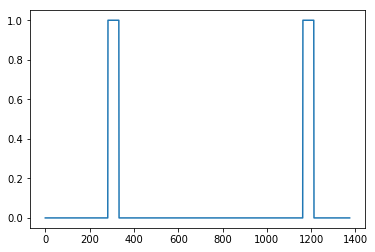

In [5]:
plt.plot(Y[0])

# 2 - Model

Now that you've built a dataset, lets write and train a trigger word detection model! 

The model will use 1-D convolutional layers, GRU layers, and dense layers. Let's load the packages that will allow you to use these layers in Keras. This might take a minute to load. 

In [6]:
from keras.callbacks import ModelCheckpoint
from keras.models import Model, load_model, Sequential
from keras.layers import Dense, Activation, Dropout, Input, Masking, TimeDistributed, LSTM, Conv1D
from keras.layers import GRU, Bidirectional, BatchNormalization, Reshape
from keras.optimizers import Adam

Using TensorFlow backend.


## 2.1 - Build the model

Here is the architecture we will use. Take some time to look over the model and see if it makes sense. 

<img src="images/model_trigger.png" style="width:600px;height:600px;">
<center> **Figure 3** </center>

One key step of this model is the 1D convolutional step (near the bottom of Figure 3). It inputs the 5511 step spectrogram, and outputs a 1375 step output, which is then further processed by multiple layers to get the final $T_y = 1375$ step output. This layer plays a role similar to the 2D convolutions you saw in Course 4, of extracting low-level features and then possibly generating an output of a smaller dimension. 

Computationally, the 1-D conv layer also helps speed up the model because now the GRU  has to process only 1375 timesteps rather than 5511 timesteps. The two GRU layers read the sequence of inputs from left to right, then ultimately uses a dense+sigmoid layer to make a prediction for $y^{\langle t \rangle}$. Because $y$ is binary valued (0 or 1), we use a sigmoid output at the last layer to estimate the chance of the output being 1, corresponding to the user having just said "activate."

Note that we use a uni-directional RNN rather than a bi-directional RNN. This is really important for trigger word detection, since we want to be able to detect the trigger word almost immediately after it is said. If we used a bi-directional RNN, we would have to wait for the whole 10sec of audio to be recorded before we could tell if "activate" was said in the first second of the audio clip.  


Implementing the model can be done in four steps:
    
**Step 1**: CONV layer. Use `Conv1D()` to implement this, with 196 filters, 
a filter size of 15 (`kernel_size=15`), and stride of 4. [[See documentation.](https://keras.io/layers/convolutional/#conv1d)]

**Step 2**: First GRU layer. To generate the GRU layer, use:
```
X = GRU(units = 128, return_sequences = True)(X)
```
Setting `return_sequences=True` ensures that all the GRU's hidden states are fed to the next layer. Remember to follow this with Dropout and BatchNorm layers. 

**Step 3**: Second GRU layer. This is similar to the previous GRU layer (remember to use `return_sequences=True`), but has an extra dropout layer. 

**Step 4**: Create a time-distributed dense layer as follows: 
```
X = TimeDistributed(Dense(1, activation = "sigmoid"))(X)
```
This creates a dense layer followed by a sigmoid, so that the parameters used for the dense layer are the same for every time step. [[See documentation](https://keras.io/layers/wrappers/).]

**Exercise**: Implement `model()`, the architecture is presented in Figure 3.

In [7]:
# GRADED FUNCTION: model

def model(input_shape):
    """
    Function creating the model's graph in Keras.
    
    Argument:
    input_shape -- shape of the model's input data (using Keras conventions)

    Returns:
    model -- Keras model instance
    """
    
    X_input = Input(shape = input_shape)
    
    ### START CODE HERE ###
    
    # Step 1: CONV layer (≈4 lines)
    X = Conv1D(196, kernel_size=15, strides=4)(X_input)                                 # CONV1D
    X = BatchNormalization()(X)                                 # Batch normalization
    X = Activation('relu')(X)                                 # ReLu activation
    X = Dropout(0.2)(X)                                 # dropout (use 0.8)

    # Step 2: First GRU Layer (≈4 lines)
    X = GRU(units = 128, return_sequences = True)(X) # GRU (use 128 units and return the sequences)
    X = Dropout(0.2)(X)                                 # dropout (use 0.8)
    X = BatchNormalization()(X)                                 # Batch normalization
    
    # Step 3: Second GRU Layer (≈4 lines)
    X = GRU(units = 128, return_sequences = True)(X)   # GRU (use 128 units and return the sequences)
    X = Dropout(0.2)(X)                                 # dropout (use 0.8)
    X = BatchNormalization()(X)                                  # Batch normalization
    X = Dropout(0.2)(X)                                  # dropout (use 0.8)
    
    # Step 4: Time-distributed dense layer (≈1 line)
    X = TimeDistributed(Dense(1, activation = "sigmoid"))(X) # time distributed  (sigmoid)

    ### END CODE HERE ###

    model = Model(inputs = X_input, outputs = X)
    
    return model  

In [8]:
model = model(input_shape = (Tx, n_freq))

Let's print the model summary to keep track of the shapes.

In [9]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 5511, 101)         0         
_________________________________________________________________
conv1d_1 (Conv1D)            (None, 1375, 196)         297136    
_________________________________________________________________
batch_normalization_1 (Batch (None, 1375, 196)         784       
_________________________________________________________________
activation_1 (Activation)    (None, 1375, 196)         0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 1375, 196)         0         
_________________________________________________________________
gru_1 (GRU)                  (None, 1375, 128)         124800    
_________________________________________________________________
dropout_2 (Dropout)          (None, 1375, 128)         0         
__________

**Expected Output**:

<table>
    <tr>
        <td>
            **Total params**
        </td>
        <td>
           522,561
        </td>
    </tr>
    <tr>
        <td>
            **Trainable params**
        </td>
        <td>
           521,657
        </td>
    </tr>
    <tr>
        <td>
            **Non-trainable params**
        </td>
        <td>
           904
        </td>
    </tr>
</table>

The output of the network is of shape (None, 1375, 1) while the input is (None, 5511, 101). The Conv1D has reduced the number of steps from 5511 at spectrogram to 1375. 

## 2.2 - Fit the model

Trigger word detection takes a long time to train. To save time, we've already trained a model for about 3 hours on a GPU using the architecture you built above, and a large training set of about 4000 examples. Let's load the model. 

In [10]:
model = load_model('./models/tr_model.h5')

/root/.virtualenvs/gpu-py3/lib/python3.5/site-packages/keras/engine/saving.py:327: UserWarning: Error in loading the saved optimizer state. As a result, your model is starting with a freshly initialized optimizer.
  warnings.warn('Error in loading the saved optimizer '


In [11]:
from keras import backend as K

def recall_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

def precision_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision

def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))

You can train the model further, using the Adam optimizer and binary cross entropy loss, as follows. This will run quickly because we are training just for one epoch and with a small training set of 26 examples. 

In [12]:
opt = Adam(lr=0.0001, beta_1=0.9, beta_2=0.999, decay=0.01)
# model.compile(loss='binary_crossentropy', optimizer=opt, metrics=["accuracy"])

model.compile(loss='binary_crossentropy', optimizer=Adam(), metrics=["accuracy"])
# model.compile(loss='binary_crossentropy', optimizer=Adam(), metrics=['acc', f1_m, precision_m, recall_m])

In [13]:
# model.fit(X, Y, batch_size = 5, epochs=1)
model.fit(X, Y, batch_size = 16, epochs = 10)
# model.fit(X, Y, batch_size = 16, epochs = 10, validation_split = 0.3)

Epoch 1/10
3501/3501 [==============================] - 555s 158ms/step - loss: 0.1358 - acc: 0.9568
Epoch 2/10
3501/3501 [==============================] - 548s 156ms/step - loss: 0.0825 - acc: 0.9726
Epoch 3/10
3501/3501 [==============================] - 547s 156ms/step - loss: 0.0811 - acc: 0.9748
Epoch 4/10
3501/3501 [==============================] - 547s 156ms/step - loss: 0.0714 - acc: 0.9775
Epoch 5/10
3501/3501 [==============================] - 547s 156ms/step - loss: 0.0999 - acc: 0.9642
Epoch 6/10
3501/3501 [==============================] - 547s 156ms/step - loss: 0.0634 - acc: 0.9782
Epoch 7/10
3501/3501 [==============================] - 547s 156ms/step - loss: 0.0554 - acc: 0.9811
Epoch 8/10
3501/3501 [==============================] - 547s 156ms/step - loss: 0.0616 - acc: 0.9793
Epoch 9/10
3501/3501 [==============================] - 547s 156ms/step - loss: 0.0483 - acc: 0.9834
Epoch 10/10
3501/3501 [==============================] - 547s 156ms/step - loss: 0.0454 - a

# 3 - Making Predictions

Now that you have built a working model for trigger word detection, let's use it to make predictions. This code snippet runs audio (saved in a wav file) through the network. 

<!--
can use your model to make predictions on new audio clips.

You will first need to compute the predictions for an input audio clip.

**Exercise**: Implement predict_activates(). You will need to do the following:

1. Compute the spectrogram for the audio file
2. Use `np.swap` and `np.expand_dims` to reshape your input to size (1, Tx, n_freqs)
5. Use forward propagation on your model to compute the prediction at each output step
!-->

In [14]:
def detect_triggerword(filename):
    plt.subplot(2, 1, 1)

    x = graph_spectrogram(filename)
    # the spectogram outputs (freqs, Tx) and we want (Tx, freqs) to input into the model
    x  = x.swapaxes(0,1)
    x = np.expand_dims(x, axis=0)
    predictions = model.predict(x)
    
    plt.subplot(2, 1, 2)
    plt.plot(predictions[0,:,0])
    plt.ylabel('probability')
    plt.show()
    return predictions

Once you've estimated the probability of having detected the word "activate" at each output step, you can trigger a "chiming" sound to play when the probability is above a certain threshold. Further, $y^{\langle t \rangle}$ might be near 1 for many values in a row after "activate" is said, yet we want to chime only once. So we will insert a chime sound at most once every 75 output steps. This will help prevent us from inserting two chimes for a single instance of "activate". (This plays a role similar to non-max suppression from computer vision.) 

<!-- 
**Exercise**: Implement chime_on_activate(). You will need to do the following:

1. Loop over the predicted probabilities at each output step
2. When the prediction is larger than the threshold and more than 75 consecutive time steps have passed, insert a "chime" sound onto the original audio clip

Use this code to convert from the 1,375 step discretization to the 10,000 step discretization and insert a "chime" using pydub:

` audio_clip = audio_clip.overlay(chime, position = ((i / Ty) * audio.duration_seconds)*1000)
`
!--> 

In [15]:
chime_file = "audio_examples/chime.wav"
def chime_on_activate(filename, predictions, threshold):
    audio_clip = AudioSegment.from_wav(filename)
    chime = AudioSegment.from_wav(chime_file)
    Ty = predictions.shape[1]
    # Step 1: Initialize the number of consecutive output steps to 0
    consecutive_timesteps = 0
    # Step 2: Loop over the output steps in the y
    for i in range(Ty):
        # Step 3: Increment consecutive output steps
        consecutive_timesteps += 1
        # Step 4: If prediction is higher than the threshold and more than 75 consecutive output steps have passed
        if predictions[0,i,0] > threshold and consecutive_timesteps > 75:
            # Step 5: Superpose audio and background using pydub
            audio_clip = audio_clip.overlay(chime, position = ((i / Ty) * audio_clip.duration_seconds)*1000)
            # Step 6: Reset consecutive output steps to 0
            consecutive_timesteps = 0
        
    audio_clip.export("chime_output.wav", format='wav')

## 3.3 - Test on dev examples

Let's explore how our model performs on two unseen audio clips from the development set. Lets first listen to the two dev set clips. 

In [16]:
IPython.display.Audio("./raw_thalon_audios/train_2.wav")

In [17]:
IPython.display.Audio("./raw_thalon_audios/train_9.wav")

Now lets run the model on these audio clips and see if it adds a chime after "activate"!

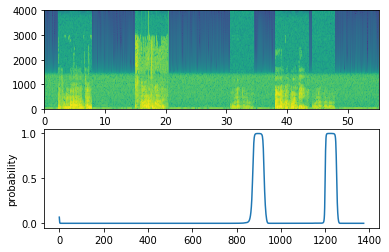

In [18]:
filename = "./raw_thalon_audios/train_1.wav"
prediction = detect_triggerword(filename)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("./chime_output.wav")

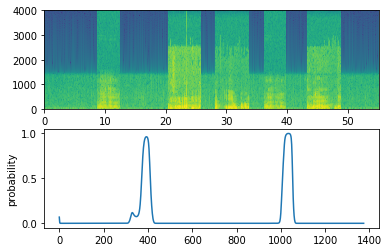

In [31]:
filename  = "./raw_thalon_audios/train_9.wav"
prediction = detect_triggerword(filename)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("./chime_output.wav")

In [32]:
model.save('hola_thalon_trigger.h5')

In [37]:
def detect_triggerword2(filename):
    plt.subplot(2, 1, 1)

    x = graph_spectrogram(filename)
    # the spectogram outputs (freqs, Tx) and we want (Tx, freqs) to input into the model
    x  = x.swapaxes(0,1)
    x = np.expand_dims(x, axis=0)
    predictions = model2.predict(x)
    
    plt.subplot(2, 1, 2)
    plt.plot(predictions[0,:,0])
    plt.ylabel('probability')
    plt.show()
    return predictions

In [35]:
from keras.models import load_model

model2 = load_model('hola_thalon_trigger.h5')
model2.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         (None, 5511, 101)         0         
_________________________________________________________________
conv1d_3 (Conv1D)            (None, 1375, 256)         388096    
_________________________________________________________________
batch_normalization_7 (Batch (None, 1375, 256)         1024      
_________________________________________________________________
activation_3 (Activation)    (None, 1375, 256)         0         
_________________________________________________________________
dropout_7 (Dropout)          (None, 1375, 256)         0         
_________________________________________________________________
gru_5 (GRU)                  (None, 1375, 128)         147840    
_________________________________________________________________
dropout_8 (Dropout)          (None, 1375, 128)         0         
__________

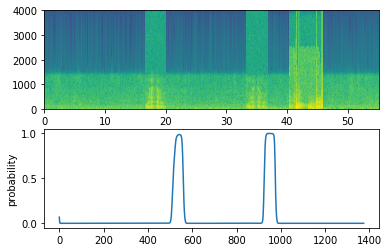

In [38]:
filename  = "./raw_thalon_audios/train_200.wav"
prediction = detect_triggerword2(filename)
chime_on_activate(filename, prediction, 0.5)

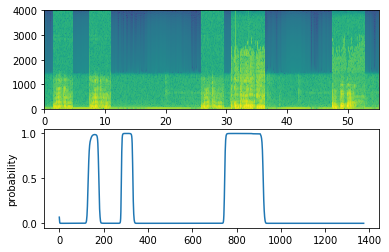

In [20]:
filename  = "./raw_thalon_audios/train_591.wav"
prediction = detect_triggerword(filename)
chime_on_activate(filename, prediction, 0.5)
IPython.display.Audio("./chime_output.wav")